## Stopping the AHEAD
    Original code by:  Max Keuken (mckeuken@gmail.com)
                       Integrative Model-based Cognitive Neuroscience 
                       (IMCN) research unit, University of Amsterdam
    Date:              Feb 2021
    Adapted by:        Sarah Kemp (sarahannekemp@gmail.com)
                       Pilou Bazin (p.l.e.a.bazin@uva.nl)
    Date:              2022
    
##### Description of the project
    The 3T DWI scans have been preprocessed using the notebook '1_Preprocessing-script-AHEAD_DWI-Notebook.ipynb'. 
    Steps like denoising, degibbing, eddy correction and bias field correction have all be applied to the data. 
    
    For a project together with Andrew Heathcote, Mark Hinder, Dora Matze, Sarah Kemp, Niek Stevenson, Pilou Bazin     
    and Birte Forstmann we want to reinvite the AHEAD subjects for a stop related task and link the 
    behavioral SSRT model parameters to the connectome of these subjects. The behavioral data ended up being not very 
    usefull as a large number of subjects did not seem to follow the task instructions. So we decided to use the data
    to determine how many new subjects we would need to test if we want to find a robust correlation between 
    age and tractstrength. Once we know this we can determine if the project is even remotely feasible. 
    
    We basically need to have the tract strengths per subject so that we can sample from it and correlate age 
    with tract strength and determine the required sample size to have a correlation that is associated with 
    a bayes factor of atleast 10.
    
    Given the quality of the data we can use spherical deconvolution but we chose not to use processing steps
    such as Anatomical Constrained Tractography (ACT) as most of the subcortex is missing as priors in this
    pipeline. We tried to keep it as straightforward as possible. 
    
    

##### Description of the pipeline
- [X] 0) read the demographics and get the DWI data
- [X] 1) create a basis function (dwi2response)
- [X] 2) Estimate the Fiber Orientation Density (FOD) and the global tractography using tckglobal 
- [X] 3) Refining the streamlining using SIFT2
- [X] 4) Create the ROIs for tracking
- [X] 5) Estimate the connectome for my cortical and subcortical areas of interest 
- [X] 6) Extract the streamlines between nodes for visual inspectation
- [X] 7) Create a dataframe with the streamcounts for all subjects
- [X] 8) Register the B0's to MNI space and apply to mean tracks
- [X] Did you do all the quality control checks??
    
##### Software versions
    mrtrix V3.0.2
    fsl V5.0.11
    ants via python (antspyx V0.2.4)

In [1]:
#################################################################################
## Import the modules
#################################################################################
import pandas as pd, numpy as np, glob, re, seaborn as sns, matplotlib.pyplot as plt
import shutil, subprocess, sys, os, ants, nibabel as nib

from multiprocessing import Pool
#################################################################################

In [2]:
#################################################################################
## 0) Variables, demographics and dwi data
#################################################################################
# Path settings
mainProjectFolder = '/home/public/StoppingAge-DWI-Ahead/'
demographicsDataFolder = 'Data/Demographics/'
dwiDataFolder = 'Data/Dwi/'
dwiDerivativeFolder = 'Data/Derivatives/'
preprocessedDataFolder = '/home/public/HumanAtlas_BIDS/'
    
# Read the demographic data 
dfDemographic = pd.read_csv(mainProjectFolder+demographicsDataFolder+'StoppingAge-DWI-AHEAD-Demographics-ALL-DWI.csv')

# The names of the subjects are not however in the BIDS format. So lets convert them:
# Note that I'm not using the subjectID codes as the anatomy of the 7T scans in the HumanAtlas_BIDS folder 
#. would then not match the 3T DWI scans. I.e. scancode '0017' matches the anatomy of sub-017 bids format.
subjects_bidsTmp = [item.lower() for item in dfDemographic['Scan_Code']]
subjects_bids = []
for i in range(len(subjects_bidsTmp)):
    if 'pilot' in subjects_bidsTmp[i]:
        bidsName = 'sub-'+'000'
    else:
        bidsName = 'sub-'+subjects_bidsTmp[i][11:14]
    subjects_bids.append(bidsName)
    
# Add them to the dataframe:    
dfDemographic['Subject-BIDS'] = subjects_bids
subjects = dfDemographic['Subject-BIDS']

print('How many DWI subjects do we?', len(subjects))
#################################################################################

How many DWI subjects do we? 49


In [3]:
#################################################################################
## 1) Create basis function
#################################################################################
# We are going to use the dhollander algorithm as this seems to be the preferred option 
#. with multi shell data.

# Done for all 49 subjects? Yes

overwrite = False
def createBasisFunction(subject):
    print(subject+'\n')
    
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    preprocessed_dir = work_dir+'/preprocessed'
    dwiresponse_dir = work_dir+'/dwi2response'
   
    # Location of the original dwi data
    origDWIData = preprocessedDataFolder+subject+'/ses-3/dwi/'+subject+'_ses-3_dwi-preproc.mif.gz'
    origDWIMask = preprocessedDataFolder+subject+'/ses-3/dwi/'+subject+'_ses-3_dwi_mask.mif.gz'
    
    # Location of the local copy
    inputData = preprocessed_dir+'/'+subject+'_ses-3_dwi-preproc.mif.gz'
    brainMask = preprocessed_dir+'/'+subject+'_ses-3_dwi_mask.mif.gz'
    
    # Create the output folder
    if ((os.path.exists(dwiresponse_dir)) & (overwrite == False)):
        print('\n1. Estimate Basis function: done (set overwrite to True to recompute)')
    else:
        print('\n1. Estimate Basis function')
        os.makedirs(preprocessed_dir,exist_ok=True)
        os.makedirs(dwiresponse_dir,exist_ok=True)
        
        # Make a local copy of the original data
        shutil.copy(origDWIData, inputData)
        shutil.copy(origDWIMask, brainMask)
        
        # Estimate the basis function
        #. Note that we are providing our own initial mask that we then strongly erode to ensure
        #. that the eyeballs are not included to estimate the csf and we stay clearly away from 
        #. the cortical outer edge
        command = 'dwi2response dhollander '+inputData+' '+dwiresponse_dir+'/wm.txt '+dwiresponse_dir+'/gm.txt '+dwiresponse_dir+'/csf.txt -mask '+brainMask+' -voxels '+dwiresponse_dir+'/voxels.mif -erode 15 -force'

        print(command)
        try:
             subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)

# Run the actual function     
if __name__ == '__main__':
    pool = Pool(4) # 3 threads 
    pool.imap(createBasisFunction, subjects) 
    pool.close()       

# Check a few things:
# 1) are the voxels that are used to estimate the response in a correct area (ie csf voxels in csf, wm voxels in wm etc)
#.   you can check this by looking at the voxels.mif on top of the mean BO
# 2) are the response functions as expected and do they change as you would expect with a change in B values?
#.   you can check this by looking at the text files with shview gm.txt etc
#. This all seems to be the case.
#################################################################################

sub-001
sub-006


sub-008
sub-009

1. Estimate Basis function: done (set overwrite to True to recompute)
1. Estimate Basis function: done (set overwrite to True to recompute)



1. Estimate Basis function: done (set overwrite to True to recompute)
sub-010


sub-011
sub-012



1. Estimate Basis function: done (set overwrite to True to recompute)
1. Estimate Basis function: done (set overwrite to True to recompute)

sub-013
sub-014



1. Estimate Basis function: done (set overwrite to True to recompute)
1. Estimate Basis function: done (set overwrite to True to recompute)


1. Estimate Basis function: done (set overwrite to True to recompute)sub-015

1. Estimate Basis function: done (set overwrite to True to recompute)sub-016




sub-017

1. Estimate Basis function: done (set overwrite to True to recompute)sub-018

1. Estimate Basis function: done (set overwrite to True to recompute)



sub-020
sub-022

1. Estimate Basis function: done (set overwrite to True to recompute)

1. Estimate Ba

In [4]:
#################################################################################
## 2) Estimate the Fiber Orientation Density (FOD) using dwi2fod
#################################################################################
# This was initially done using tckglobal, but there were a number of participants for whom there were very
# few streamlines. Therefore, later we reran the FOD and global tractography using dwi2fod and tckgen 
# (rather than tckglobal).

# Do you want to overwrite the previous results? If yes, then True
# Done for all 49 subjects? Yes

overwrite = False

def dwi2fod(subject):
    print(subject+'\n')
    
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    preprocessed_dir = mainProjectFolder+'Data/Dwi/'+subject+'/preprocessed'
    dwifod_dir = work_dir+'/dwi2fod'
    dwiresponse_dir = mainProjectFolder+'Data/Dwi/'+subject+'/dwi2response'
    
    # Location of the local copy
    inputData = preprocessed_dir+'/'+subject+'_ses-3_dwi-preproc.mif.gz'
    brainMask = preprocessed_dir+'/'+subject+'_ses-3_dwi_mask.mif.gz'
    
    # Create the output folder
    if ((os.path.exists(dwifod_dir)) & (overwrite == False)):
        print('\n2. Estimate FOD and run global tractography: done (set overwrite to True to recompute)')
    else:
        print('\n2. Estimate FOD and run global tractography')
        os.makedirs(dwifod_dir,exist_ok=True)
        
        # Estimate the Fiber Orientation Density (FOD)
        command = 'dwi2fod msmt_csd '+inputData+' '+dwiresponse_dir+'/wm.txt '+dwifod_dir+'/wmfod.mif '+dwiresponse_dir+'/gm.txt '+dwifod_dir+'/gmfod.mif '+dwiresponse_dir+'/csf.txt '+dwifod_dir+'/csffod.mif  -nthreads 4'
        
        print(command+'\n')
        try:
             subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
# Run the actual function with pool  
if __name__ == '__main__':
    pool = Pool(4) # n threads 
    pool.map(dwi2fod, subjects) 
    pool.close() 


# Alternatively can just loop through (takes longer):
# for subject in subjects: 
#     dwi2fod(subject)

#################################################################################

sub-001
sub-010
sub-018
sub-014





2. Estimate FOD and run global tractography: done (set overwrite to True to recompute)
2. Estimate FOD and run global tractography: done (set overwrite to True to recompute)
2. Estimate FOD and run global tractography: done (set overwrite to True to recompute)
2. Estimate FOD and run global tractography: done (set overwrite to True to recompute)



In [5]:
#################################################################################
## 3) Create tracks using the FODs just generated via dwi2fod
#################################################################################
#. Using the resulting FOD's we can use tckgen to generate tracks

# Do you want to overwrite the previous results? If yes, then True

# Done for all 49 subjects? Yes

overwrite = False

def wbStreamLineTckGen(subject):
    print(subject+'\n')
    
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    preprocessed_dir = work_dir+'/preprocessed'
    dwiresponse_dir = work_dir+'/dwi2response'
    wholebrainStreamline_dir = work_dir+'/tckgen'
    
    # Location of the local copy
    inputData = preprocessed_dir+'/'+subject+'_ses-3_dwi-preproc.mif.gz'
    brainMask = preprocessed_dir+'/'+subject+'_ses-3_dwi_mask.mif.gz'
    midlineMask = preprocessed_dir+'/midline_mask_b0.nii.gz'
    
    # Create the output folder
    if ((os.path.exists(wholebrainStreamline_dir)) & (overwrite == False)):
        print('\n2. Whole brain streamline tckgen: done (set overwrite to True to recompute)')
    else:
        print('\n2. Estimate whole brain streamlines tckgen')
        os.makedirs(wholebrainStreamline_dir, exist_ok=True)
        
        # Run the streamlines using the FOD of tckglobal and the iFOD2 algo in tckgen
        #. We also provide a midline exclusion mask that was made in fslview using the mean B0 image
        #. In terms of other parameters than standard: way more streamlines (25mil)
        command = 'tckgen '+work_dir+'/dwi2fod/wmfod.mif '+wholebrainStreamline_dir+'/tracks_25M.tck -seed_image '+brainMask+' -mask '+brainMask+' -exclude '+midlineMask+' -nthreads 4 -algorithm iFOD2 -select 25000000 -force -cutoff 0.05'

        print(command+'\n')
        try:
             subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
     
        # To be able to control the output we are going to subsample:
        command = 'tckedit '+wholebrainStreamline_dir+'/tracks_25M.tck -number 200k '+wholebrainStreamline_dir+'/smallerTracks_200k.tck -force'
        
        print(command+'\n')
        try:
             subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
# Based on the cpu use you probably don't want to run more than 5 people at a time

# Run the actual function   
if __name__ == '__main__':
    pool = Pool(4) # n threads 
    pool.map(wbStreamLineTckGen, subjects) 
    pool.close() 
    
# Check a few things:
#. Does the FOD's look oke? ie elongated on the CC? clear ascending tracts? color coding correct?
#. Yes that all seem to be the case
#################################################################################

In [6]:
#################################################################################
## 3.fix) Create tracks using the FODs just generated via dwi2fod
#################################################################################
#. Using the resulting FOD's we can use tckgen to generate tracks

# Here we run the extra fibers for inter-hemispherical connections and merge the results

# Do you want to overwrite the previous results? If yes, then True

# Done for all 49 subjects? Yes

overwrite = False

def wbStreamLineTckGenHemi(subject):
    print(subject+'\n')
    
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    preprocessed_dir = work_dir+'/preprocessed'
    dwiresponse_dir = work_dir+'/dwi2response'
    wholebrainStreamline_dir = work_dir+'/tckgen'
    
    # Location of the local copy
    inputData = preprocessed_dir+'/'+subject+'_ses-3_dwi-preproc.mif.gz'
    brainMask = preprocessed_dir+'/'+subject+'_ses-3_dwi_mask.mif.gz'
    midlineMask = preprocessed_dir+'/midline_mask_b0.nii.gz'
    
    # Create the output folder
    output = wholebrainStreamline_dir+'/tracks_combined.tck'
    if ((os.path.exists(output)) & (overwrite == False)):
        print('\n2. Whole brain streamline tckgen: done (set overwrite to True to recompute)')
    else:
        print('\n2. Estimate whole brain streamlines tckgen')
        os.makedirs(wholebrainStreamline_dir, exist_ok=True)
        
        # Run the command for the inter-hemispheric separation only
        # To fix the fact we had the exclusion step before :(
        # 5M additional streamlines seem to make the streamline weights converge in testing
        command = 'tckgen '+work_dir+'/dwi2fod/wmfod.mif '+wholebrainStreamline_dir+'/tracks_5M.tck -seed_image '+midlineMask+' -mask '+brainMask+' -include '+midlineMask+' -nthreads 4 -algorithm iFOD2 -select 5000000 -force -cutoff 0.05'

        print(command+'\n')
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
     
    output = wholebrainStreamline_dir+'/tracks_combined.tck'
    if ((os.path.exists(output)) & (overwrite == False)):
        print('\n2b. Whole brain streamline merging: done (set overwrite to True to recompute)')
    else:
        print('\n2b. Merge whole brain streamlines')
        
        # merge both files
        command = 'tckedit '+wholebrainStreamline_dir+'/tracks_25M.tck '+wholebrainStreamline_dir+'/tracks_5M.tck '+wholebrainStreamline_dir+'/tracks_combined.tck -force'
        print(command+'\n')
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)

        # To be able to control the output we are going to subsample:
        command = 'tckedit '+wholebrainStreamline_dir+'/tracks_combined.tck -number 200k '+wholebrainStreamline_dir+'/smallerTracks_200k.tck -force'
        
        print(command+'\n')
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
# Based on the cpu use you probably don't want to run more than 5 people at a time

# Run the actual function   
if __name__ == '__main__':
    pool = Pool(4) # n threads 
    pool.map(wbStreamLineTckGenHemi, subjects) 
    pool.close() 
    
# Check a few things:
#. Does the FOD's look oke? ie elongated on the CC? clear ascending tracts? color coding correct?
#. Yes that all seem to be the case
#################################################################################

In [16]:
#################################################################################
## 4) Midway sanity check: check number of streamlines generated 
#################################################################################

# This module uses tckstats (from MRtrix 3.0) to count the number of streamlines that were 
# generated per person in the previous module in the "command = tckgen..." line. 
# If this number is something other than 25 million (or whatever number was specified, that
# indicates that the process might have been interrupted and should be rerun (e.g. if you 
# ran out of diskspace or if the server was restarted).


def checkStreamlines(subject):
    
    # File just generated by the previous module is here
    tckFolder = mainProjectFolder+'Data/Dwi/'+subject+'/tckgen/'
    

    # Bash command to count the number of streamlines 
    command = 'tckstats '+tckFolder+'tracks_combined.tck -output count' 
    print(command+'\n')

    # run the command and print out the result 
    subprocess.run(command, shell=True) 

        
# Run the actual function   
if __name__ == '__main__':
    pool = Pool(4) # n threads 
    pool.map(checkStreamlines, subjects) 
    pool.close() 
    
#####
# 25mil generated for each person so looks good to proceed
##### 

tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-014/tckgen/tracks_25M.tck -output count
tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-010/tckgen/tracks_25M.tck -output count
tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/tckgen/tracks_25M.tck -output count
tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tckgen/tracks_25M.tck -output count






tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K
tckstats: [ 88%] Reading track file...

tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-008/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K
tckstats: [  8%] Reading track file...

tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/tckgen/tracks_25M.tck -output count



tckstats: [ 96%] Reading track file...

25000000 


tckstats: [100%] Reading track file[0K
tckstats: [  3%] Reading track file...

tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-022/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-013/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/tckgen/tracks_25M.tck -output count



tckstats: [  5%] Reading track file...

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K
tckstats: [  1%] Reading track file...

tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-017/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-023/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-048/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-031/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/tckgen/tracks_25M.tck -output count



tckstats: [ 98%] Reading track file...

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-032/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-060/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K
tckstats: [ 18%] Reading track file...

tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K
tckstats: [ 90%] Reading track file...

tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-056/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K
tckstats: [ 79%] Reading track file...

tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/tckgen/tracks_25M.tck -output count



tckstats: [ 30%] Reading track file...

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-071/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K
tckstats: [  8%] Reading track file...

tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-065/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/tckgen/tracks_25M.tck -output count



tckstats: [ 28%] Reading track file...

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/tckgen/tracks_25M.tck -output count



tckstats: [ 10%] Reading track file...

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-103/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K
tckstats: [  1%] Reading track file...

tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-086/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K
tckstats: [ 64%] Reading track file...

25000000 


tckstats: [100%] Reading track file[0K


tckstats /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-095/tckgen/tracks_25M.tck -output count

25000000 


tckstats: [100%] Reading track file[0K
tckstats: [ 96%] Reading track file...

25000000 


tckstats: [100%] Reading track file[0K


25000000 


tckstats: [100%] Reading track file[0K


25000000 


In [7]:
#################################################################################
## 5) refining the streamlinings of tckgen while using the fod from tckglobal using SIFT2
#################################################################################
# Do you want to overwrite the previous results? If yes, then True
# Done for all 49 subjects? Yes
overwrite = False

def sift2Refining(subject):    
    print(subject+'\n')
    
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    preprocessed_dir = work_dir+'/preprocessed'
    dwiresponse_dir = work_dir+'/dwi2response'
    wholebrainStreamline_dir = work_dir+'/tckgen'
    fod_dir = work_dir+'/dwi2fod'
    sift2_dir = work_dir+'/SIFT2-tckgen'
    
    # Create the output folder
    if ((os.path.exists(sift2_dir)) & (overwrite == False)):
        print('\n3. Refine the streamlines from tckgen using SIFT2: done (set overwrite to True to recompute)')
    else:
        print('\n3. Refine the streamlines from tckgen using SIFT2')
        os.makedirs(sift2_dir,exist_ok=True)

        # Clean up the streamlines
        # standard sift2 algoritm
        command = 'tcksift2 -out_mu '+sift2_dir+'/sift_mu.txt -out_coeffs '+sift2_dir+'/sift_coeffs.txt -nthreads 4 '+wholebrainStreamline_dir+'/tracks_combined.tck '+fod_dir+'/wmfod.mif '+sift2_dir+'/sift.txt -force'
        print(command+'\n')
        try:
             subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)


# Run the actual function   
if __name__ == '__main__':
    pool = Pool(1) 
    pool.map(sift2Refining, subjects) 
    pool.close() 
#################################################################################

In [ ]:
#################################################################################
## 6) create the ROIs for tracking
#################################################################################
# We need an input file for the connectome that has the bilateral 3 ROI's:
#.   STN, IFG, preSMA
#.   The STN are based on MASSP, the IFG and preSMA are based on the masks of Rogier Mars 
#. 
# We need to do a few things:
#.  1. Get the IFG and preSMA MNI masks registered to DWI space
#.  2a. Threshold the STN masks to ensure that we only select the voxels that MASSP is pretty certain about (robust range higher than 20% of probability)
#.  2b. Get the thresholded STN masks to DWI space, binarize them
#.  3. Combine the STN, IFG and preSMA masks into a single nifti file
#. 
#. All registrations will be visually checked to see if the masks end up where they should be. 
#. A few of them will need some manual tweaking in terms of parameters. 
#. 
#. Landmarks that were mainly used to check for allignment were the corpus callosum, pons, and ventricles 
#. 
# Done for all 49 subjects? 
###############################
# 1) MNI masks to B0 space
###############################
# subjects_extra = ['sub-008', 'sub-009', 'sub-010', 'sub-011', 'sub-012', 'sub-018', 'sub-023', 'sub-031', 
#                 'sub-032', 'sub-033', 'sub-041', 'sub-044', 'sub-053', 'sub-054', 'sub-056', 'sub-058', 
#                 'sub-059', 'sub-062', 'sub-063', 'sub-064', 'sub-065', 'sub-069', 'sub-070',  'sub-078',
#                 'sub-082', 'sub-083', 'sub-084', 'sub-089', 'sub-095']
for subject in subjects:
    print(subject+' MNI Masks')
    
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    preprocessed_dir = work_dir+'/preprocessed'
    
    # Location of the MNI template and masks data:
    mniTemplate1mmBrain = '/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz'
    mniIFG_l = '/home/public/StoppingAge-DWI-Ahead/Data/Atlases/mni_ifg_l_bin.nii.gz'
    mniIFG_r = '/home/public/StoppingAge-DWI-Ahead/Data/Atlases/mni_ifg_r_bin.nii.gz'
    mnipreSMA_l = '/home/public/StoppingAge-DWI-Ahead/Data/Atlases/mni_presma_l_bin.nii.gz'
    mnipreSMA_r = '/home/public/StoppingAge-DWI-Ahead/Data/Atlases/mni_presma_r_bin.nii.gz'
    
    # Create mean B0 image
    # Location of the local copy of the DWI data
    inputData = preprocessed_dir+'/'+subject+'_ses-3_dwi-preproc.mif.gz'
    
    # 1a) First create the mean B0 images
    command = 'dwiextract '+inputData+' - -bzero | mrmath - mean '+preprocessed_dir+'/mean_b0.mif -axis 3 -force'
    print(command+'\n')
    try:
         subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
    except subprocess.CalledProcessError as e:
        msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
        raise subprocess.CalledProcessError(msg)

    # 1b) Convert the mean B0 mif to a nifti 
    command = 'mrconvert '+preprocessed_dir+'/mean_b0.mif '+preprocessed_dir+'/mean_b0.nii.gz -force'
    print(command+'\n')
    try:
         subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
    except subprocess.CalledProcessError as e:
        msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
        raise subprocess.CalledProcessError(msg)  
        
    # Assign Mean B0 to variable:    
    meanB0Image = preprocessed_dir+'/mean_b0.nii.gz'
    
    # 1) Estimate deformation field MNI (moving) -> B0 (fixed) using ANTs
    #. We are going to do this in two stages as we found out that this seemed to improve the results
    #. Specifically first we are using the standard SyN and then improve the registration by using SyNAggro
    #. “SyN”: Symmetric normalization: Affine + deformable transformation, with mutual information as optimization metric.
    #. “SyNAggro”: SyN, but with more aggressive registration (fine-scale matching and more deformation)
    registrationSteps = [1, 2]
    for registrationStep in registrationSteps:
        if registrationStep == 1:
            fixed = ants.image_read(meanB0Image)
            moving = ants.image_read(mniTemplate1mmBrain)
            #fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)

            mytx1 = ants.registration(fixed = fixed , moving = moving, type_of_transform = 'SyN', write_composite_transform = True)
            warped_moving = mytx1['warpedmovout']
            #fixed.plot(overlay = warped_moving, title = 'After First Registration', overlay_alpha = 0.5)
            
        if registrationStep == 2:
            fixed = ants.image_read(meanB0Image)
            moving = mytx1['warpedmovout']
            #fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)

            mytx2 = ants.registration(fixed = fixed , moving = moving, type_of_transform = 'SyNAggro', write_composite_transform = True)
            warped_moving = mytx2['warpedmovout']
            #fixed.plot(overlay = warped_moving, title = 'After Second Registration', overlay_alpha = 0.5)
            
    # Check if the direct registration worked
    fixed = ants.image_read(meanB0Image)
    moving = ants.image_read(mniTemplate1mmBrain)
    fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
    warpedimage = ants.apply_transforms(fixed=fixed, moving=moving, transformlist=[mytx1['fwdtransforms'], mytx2['fwdtransforms']])
    fixed.plot(overlay = warpedimage, title = 'After Direct Registration', overlay_alpha = 0.5)
    
    # 2) Apply the two transformation fields to the MNI masks
    maskList = [mniIFG_l, mniIFG_r, mnipreSMA_l, mnipreSMA_r]
    for mask in maskList:
        
        inputMask = mask
        outputName = 'B0_'+inputMask.split('/')[-1]
        outputImageName = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/'+outputName
    
        fixed = ants.image_read(meanB0Image)
        moving = ants.image_read(inputMask)
        
        #fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
        warpedimage = ants.apply_transforms(fixed=fixed, moving=moving, transformlist=[mytx1['fwdtransforms'], mytx2['fwdtransforms']])
        #fixed.plot(overlay = warpedimage, title = 'After Registration', overlay_alpha = 0.5)
        
        # 3) Save the ants image to nifti
        # Export the ANTSimage to a nifti via nibabel
        fixedNibabel = ants.to_nibabel(fixed)
        warpedimageNibabel = ants.to_nibabel(warpedimage)
        # Where I need to copy the affine matrix of the B0 image because the warpfield does something weird with the matrix
        #. which then interfers with mrview
        mask2Nifti = warpedimageNibabel.__class__(warpedimageNibabel.dataobj[:], fixedNibabel.affine, warpedimageNibabel.header)
        mask2Nifti.to_filename(outputImageName)
    ###############################
    # For a few subjects the SyNAggro did not result in satisfactory registrations.
    #. Therefore we reran those but now using SyNBoldAff instead. This was after 
    #.  testing a number of different methods  
    #. 
    # 1) MNI masks to B0 space redo 
    ###############################    
    subjectsRedo = ['sub-060', 'sub-091']
    if subject in subjectsRedo:
        # 1) Estimate deformation field MNI (moving) -> B0 (fixed) using ANTs
        fixed = ants.image_read(meanB0Image)
        moving = ants.image_read(mniTemplate1mmBrain)
        
        fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
        mytx1 = ants.registration(fixed = fixed , moving = moving, type_of_transform = 'SyNBoldAff', write_composite_transform = True)
        warped_moving = mytx1['warpedmovout']
        fixed.plot(overlay = warped_moving, title = 'After single stage Registration', overlay_alpha = 0.5)

        # 2) Apply the transformation field to the MNI masks
        maskList = [mniIFG_l, mniIFG_r, mnipreSMA_l, mnipreSMA_r]
        for mask in maskList:

            inputMask = mask
            outputName = 'B0_'+inputMask.split('/')[-1]
            outputImageName = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/'+outputName

            fixed = ants.image_read(meanB0Image)
            moving = ants.image_read(inputMask)

            #fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
            warpedimage = ants.apply_transforms(fixed=fixed, moving=moving, transformlist=mytx1['fwdtransforms'])#, imagetype=3)
            #fixed.plot(overlay = warpedimage, title = 'After Registration', overlay_alpha = 0.5)

            # 3) Save the ants image to nifti
            # Export the ANTSimage to a nifti via nibabel
            fixedNibabel = ants.to_nibabel(fixed)
            warpedimageNibabel = ants.to_nibabel(warpedimage)
            # Where I need to copy the affine matrix of the B0 image because the warpfield does something weird with the matrix
            #. which then interfers with mrview
            mask2Nifti = warpedimageNibabel.__class__(warpedimageNibabel.dataobj[:], fixedNibabel.affine, warpedimageNibabel.header)
            mask2Nifti.to_filename(outputImageName)
        
###############################
# 2) MASSP masks to B0 space
###############################
###############################
# 2a) First get the MASSP masks and threshold them based on the robust range of 50% of the probability values
#. in the mask and binarize them:
###############################
for subject in subjects:
    print(subject + ' MASSP Masks')
    # The MASSP files:
    labelImage = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/*_massp-label.nii.gz'
    probImage = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/*_massp-proba.nii.gz'
    
    # The resulting seperate subcortical labels
    stn_l_label = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/stn_l_label.nii.gz'
    stn_r_label = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/stn_r_label.nii.gz'
     
    stn_l_proba = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/stn_l_proba.nii.gz'
    stn_r_proba = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/stn_r_proba.nii.gz'
     
    stn_l_mask = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/stn_l_masks.nii.gz'
    stn_r_mask = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/stn_r_masks.nii.gz'

    maskLabels = [stn_l_label, stn_r_label]
    maskProba = [stn_l_proba, stn_r_proba]
    maskNames = [stn_l_mask, stn_r_mask]
    
    # Split the 3D label file into its different masks based on the intensity value
    #.  Where stn l is 3 and stn r is equal to 4 
    #.   so don't change the order of maskNames
    for i in (3,4):
        command = 'fslmaths '+labelImage+' -thr '+str(i)+' -uthr '+str(i)+' '+maskLabels[i-3] 
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
    # Get the probability values in a mask
    for i in (3,4):
        command = 'fslmaths '+probImage+' -mas '+maskLabels[i-3]+' '+maskProba[i-3]
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
    # Use robust range 
    for i in (3,4):
        command = 'fslmaths '+maskProba[i-3]+' -thrp 0.05 '+maskProba[i-3]
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
    # Binarize the masks (you can combine the statements but I rather check the intermediate steps)
    for i in (3,4):
        command = 'fslmaths '+maskProba[i-3]+' -bin '+maskNames[i-3]
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
###############################
# Step 2b) register the whole brain mp2rage to B0 and apply transformation matrix to the binarized masks
###############################
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    preprocessed_dir = work_dir+'/preprocessed'
    
    # Location of the original T1 data, ideally from the first session, if not available, use the second session:
    #. NOTE that we are getting the data from the AHEAD BIDS data folder so that we don't need to create a local 
    #. copy.
    origT1DataSES1 = preprocessedDataFolder+subject+'/ses-1/anat/wb/bet/'+subject+'_ses-1_acq-wb_mod-t1w_orient-std_brain.nii.gz'
    origT1DataSES2 = preprocessedDataFolder+subject+'/ses-2/anat/wb/bet/'+subject+'_ses-2_acq-wb_mod-t1w_orient-std_brain.nii.gz'
    if (os.path.exists(origT1DataSES1)):
        print('Using the 7T scan of the first session\n')
        origT1Data = origT1DataSES1
        if subject == 'sub-070':
            origT1Data = origT1DataSES2 # First session of this subject is incorrect and you must use ses2
    else:
        print('Using the 7T scan of the SECOND session\n')
        origT1Data = origT1DataSES2
        
    # meanB0Image
    meanB0Image = preprocessed_dir+'/mean_b0.nii.gz'
    
    # 1) Estimate deformation field using ANTs T1 (moving) -> mean B0 (fixed)
    #. 
    #. We are going to do this in two stages as we found out that this seemed to improve the results
    #. Specifically first we are using the standard DenseRigid and then improve the registration by using SyNAggro
    #. “DenseRigid”: Rigid transformation: Only rotation and translation. Employs dense sampling during metric estimation.’
    #. “SyNRA”: Symmetric normalization: Rigid + Affine + deformable transformation, with mutual information as optimization metric.
    
    registrationSteps = [1, 2]
    for registrationStep in registrationSteps:
        if registrationStep == 1:
            fixed = ants.image_read(meanB0Image)
            moving = ants.image_read(origT1Data)
            #fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
            mytx3 = ants.registration(fixed = fixed , moving = moving, type_of_transform = 'DenseRigid', write_composite_transform = True)
            warped_moving = mytx3['warpedmovout']
            #fixed.plot(overlay = warped_moving, title = 'After First Registration', overlay_alpha = 0.5)
            
        if registrationStep == 2:
            fixed = ants.image_read(meanB0Image)
            moving = mytx3['warpedmovout']
            #fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
            mytx4 = ants.registration(fixed = fixed , moving = moving, type_of_transform = 'SyNRA', write_composite_transform = True)
            warped_moving = mytx4['warpedmovout']
            #fixed.plot(overlay = warped_moving, title = 'After Second Registration', overlay_alpha = 0.5)
    
    # Check if the direct registration worked
    fixed = ants.image_read(meanB0Image)
    moving = ants.image_read(origT1Data)
    fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
    warpedimage = ants.apply_transforms(fixed=fixed, moving=moving, transformlist=[mytx3['fwdtransforms'], mytx4['fwdtransforms']])
    fixed.plot(overlay = warpedimage, title = 'After Direct Registration', overlay_alpha = 0.5)
    
    # Apply to masks
    for mask in maskNames:
        inputMask = mask
        outputName = 'B0_'+inputMask.split('/')[-1]
        outputImageName = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/'+outputName
    
        fixed = ants.image_read(meanB0Image)
        moving = ants.image_read(inputMask)
        
        #fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
        warpedimage = ants.apply_transforms(fixed=fixed, moving=moving, transformlist=[mytx3['fwdtransforms'], mytx4['fwdtransforms']])
        #fixed.plot(overlay = warpedimage, title = 'After Registration', overlay_alpha = 0.5)

        # 3) Save the ants image to nifti
        # Export the ANTSimage to a nifti via nibabel
        fixedNibabel = ants.to_nibabel(fixed)
        warpedimageNibabel = ants.to_nibabel(warpedimage)
        # Where I need to copy the affine matrix of the B0 image because the warpfield does something weird with the matrix
        #. which then interfers with mrview
        mask2Nifti = warpedimageNibabel.__class__(warpedimageNibabel.dataobj[:], fixedNibabel.affine, warpedimageNibabel.header)
        mask2Nifti.to_filename(outputImageName)
    
    
###############################        
# Step 3) Binarize all the masks in B0 space and combine them in a single nifti
###############################
for subject in subjects:
    print(subject + ' Combine MNI and MASSP masks')
    
    stn_l_b0_mask = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/B0_stn_l_masks.nii.gz'
    stn_r_b0_mask = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/B0_stn_r_masks.nii.gz'
    ifg_l_b0_mask = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/B0_mni_ifg_l_bin.nii.gz'
    ifg_r_b0_mask = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/B0_mni_ifg_r_bin.nii.gz'
    presma_l_b0_mask = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/B0_mni_presma_l_bin.nii.gz'
    presma_r_b0_mask = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/B0_mni_presma_r_bin.nii.gz'
    
    combinedMaskConnectome = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/B0_corticalSubcorticalROI.nii.gz'
    inputConnectome = '/home/public/StoppingAge-DWI-Ahead/Data/Derivatives/'+subject+'/B0_corticalSubcorticalROI.mif'
    
    b0masks = [stn_l_b0_mask, stn_r_b0_mask, ifg_l_b0_mask, ifg_r_b0_mask, presma_l_b0_mask, presma_r_b0_mask]
    
    # Binarize the masks and multiple with value to get 6 different mask labels
    labelCounter = 1
    for b0mask in b0masks:
        command = 'fslmaths '+b0mask+' -bin -mul '+str(labelCounter)+' '+b0mask
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
        labelCounter += 1
    
    # Combine the masks in a single nifti
    command = 'fslmaths '+b0masks[0]+' -add '+b0masks[1]+' -add '+b0masks[2]+' -add '+b0masks[3]+' -add '+b0masks[4]+' -add '+b0masks[5]+' '+combinedMaskConnectome
    subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
   
    # Convert the file to mif for mrtrix
    command = 'mrconvert '+combinedMaskConnectome+' '+inputConnectome+' -force'
    subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)

# All combined mask files have been checked in MRview while overlaying it with the 
#. mean B0 image. All masks seemed to be located in a plausible location.
#################################################################################

In [8]:
#################################################################################
## 7) Generate the connectome 
#################################################################################
#. Here we want to extract the number of streamlines between the ROI's that are
#. weighted based on the SIFT2 and normalized for node volume. Specifically 
#. the contribution to the connectome edge is scaled by the inverse of the two
#. node volumes. 
#. 
# Run for al 49 subjects? Yes
# Do you want to overwrite the previous results? If yes, then True
overwrite = False

def genConnectome(subject):
    print(subject+'\n')
    
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    preprocessed_dir = work_dir+'/preprocessed'
    dwiresponse_dir = work_dir+'/dwi2response'
    wholebrainStreamline_dir = work_dir+'/tckgen'
    sift2_dir = work_dir+'/SIFT2-tckgen'
    connectome_dir = work_dir+'/tck2connectome'
    
    # ROI 
    connectomeNodes_dir = mainProjectFolder+dwiDerivativeFolder+subject
    
    # Create the output folder
    if ((os.path.exists(connectome_dir)) & (overwrite == False)):
        print('\n4. Generate connectome: done (set overwrite to True to recompute)')
    else:
        print('\n4. Generate connectome')
        os.makedirs(connectome_dir,exist_ok=True)
        
        command = 'tck2connectome '+wholebrainStreamline_dir+'/tracks_combined.tck '+connectomeNodes_dir+'/B0_corticalSubcorticalROI.mif '+connectome_dir+'/connectome.csv -tck_weights_in '+sift2_dir+'/sift.txt -out_assignments '+connectome_dir+'/assignments.txt -scale_invnodevol -zero_diagonal -force'
        
        print(command+'\n')
        try:
             subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
# Run the actual function   
if __name__ == '__main__':
    pool = Pool(1) 
    pool.map(genConnectome, subjects) 
    pool.close()            
#################################################################################           

In [4]:
#################################################################################
## 8) Extract the streamlines between nodes
#################################################################################
#. Here we want to extract the streamlines so that we can overlay the resulting 
#. tck images with the B0 and node image to make sure that the streamlines make 
#. somewhat anatomical sense. Note that we are not using the option 'exclusive'
#. as a lot of voxels are shared between the striatum and stn towards the cortex
#. 
# Have you done it for all 49 subjects? Yes
# Do you want to overwrite the previous results? If yes, then True
overwrite = False

def extractStreamlinesPerNodePair(subject):
    print(subject+'\n')
    
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    preprocessed_dir = work_dir+'/preprocessed'
    dwiresponse_dir = work_dir+'/dwi2response'
    wholebrainStreamline_dir = work_dir+'/tckgen'
    sift2_dir = work_dir+'/SIFT2-tckgen'
    connectome_dir = work_dir+'/tck2connectome'
    tract_dir = work_dir+'/connectome2tck'
    
    # ROI 
    connectomeNodes_dir = mainProjectFolder+dwiDerivativeFolder+subject
    
    # Create the output folder
    if ((os.path.exists(tract_dir)) & (overwrite == False)):
        print('\n4. Extract streamlines from connectome: done (set overwrite to True to recompute)')
    else:
        print('\n4. Extract streamlines from connectome')
        os.makedirs(tract_dir,exist_ok=True)
        
        command = 'connectome2tck -tck_weights_in '+sift2_dir+'/sift.txt -prefix_tck_weights_out '+sift2_dir+'/tckweights_ '+wholebrainStreamline_dir+'/tracks_combined.tck '+connectome_dir+'/assignments.txt '+tract_dir+'/egde- -force'
                
        print(command+'\n')
        try:
             subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
# Run the actual function   
if __name__ == '__main__':
    pool = Pool(6)
    pool.imap(extractStreamlinesPerNodePair, subjects) 
    pool.close()            
#################################################################################            

sub-001
sub-006
sub-008
sub-011

sub-010

sub-009


4. Extract streamlines from connectome

4. Extract streamlines from connectome
4. Extract streamlines from connectome



4. Extract streamlines from connectome


4. Extract streamlines from connectome
4. Extract streamlines from connectome


connectome2tck -tck_weights_in /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/SIFT2-tckgen/sift.txt -prefix_tck_weights_out /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/SIFT2-tckgen/tckweights_ /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/tckgen/tracks_combined.tck /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/tck2connectome/assignments.txt /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/connectome2tck/egde- -force
connectome2tck -tck_weights_in /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/SIFT2-tckgen/sift.txt -prefix_tck_weights_out /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/SIFT2-tckgen/tckweights_ /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/

In [5]:
#################################################################################   
# 9) Count the number of streamlines for each track
################################################################################# 
# Originally we were doing this using tckstats count, but this seemed to just count the number of rows
# in each array rather than summing their value. Therefore to count the number of streamlines for each 
# track, we're just using numpy.sum on each of the csv fiules we just generated using connectome2tck


listOflists = []


print('\nHow many subjects do we have? ', len(subjects))
for subject in subjects:
    print(subject)
    
    # Local path 
    work_dir = mainProjectFolder+dwiDataFolder+subject
    sift2_dir = work_dir+'/SIFT2-tckgen'

    # meaningful labels to give the final text file 
    hemisphereNames= np.repeat(['left', 'right'],3)
    anatomicalPairNames = ['STN-IFG', 'STN-preSMA', 'IFG-preSMA', 'STN-IFG', 'STN-preSMA', 'IFG-preSMA']
    
    # tracts - sum the tracts that are listed here 
    # the order of this list needs to match hemisphereNames and ananatomicalPairNames
    coordinatePairs = ['1-3', '1-5', '3-5', '2-4', '2-6', '4-6'] 
    
    for (hemisphere, ROI, track) in zip(hemisphereNames, anatomicalPairNames, coordinatePairs):
        readfile = np.array(pd.read_csv(sift2_dir+'/tckweights_'+track+'.csv', header = None))
        sumofweights = np.sum(readfile)
    
        
        #write it to a df 
        row = [subject, hemisphere, ROI, track, sumofweights]
        listOflists.append(row)

dfCombined = pd.DataFrame(listOflists, columns = ['subjectID', 'hemisphere', 'ROI', 'trackID', 'streamlineCount'])
dfCombined.to_csv(mainProjectFolder+dwiDataFolder+'sumofWeightedTracks.csv')


How many subjects do we have?  49
sub-001
sub-006
sub-008
sub-009
sub-010
sub-011
sub-012
sub-013
sub-014
sub-015
sub-016
sub-017
sub-018
sub-020
sub-022
sub-023
sub-025
sub-031
sub-032
sub-033
sub-040
sub-041
sub-044
sub-047
sub-048
sub-053
sub-054
sub-056
sub-058
sub-059
sub-060
sub-062
sub-063
sub-064
sub-065
sub-069
sub-070
sub-071
sub-074
sub-078
sub-082
sub-083
sub-084
sub-086
sub-089
sub-090
sub-091
sub-095
sub-103


sub-001 - generate nii track images in B0 space + B0 to MNI

Generate track-weighted files in individual space and register mean B0 to MNI space
tckmap -template /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/preprocessed/mean_b0.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/connectome2tck/egde-1-3.tck /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-1-3.nii.gz -force
tckmap -template /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/preprocessed/mean_b0.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/connectome2tck/egde-2-4.tck /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-2-4.nii.gz -force
tckmap -template /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/preprocessed/mean_b0.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/connectome2tck/egde-1-5.tck /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-1-5.nii.gz -force
tckmap -template /home/public/StoppingAge-DWI-Ahead/Data/Dwi

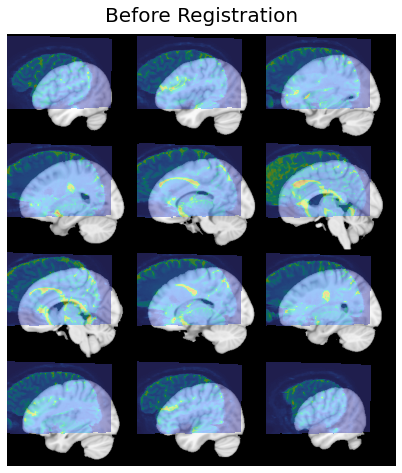

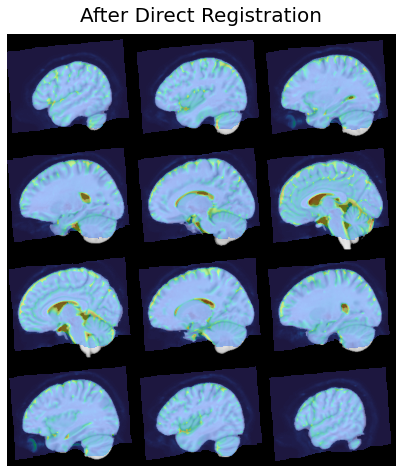

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/mni/MNI1mm_sub-001_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/mni/MNI1mm_sub-001_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/mni/MNI1mm_sub-001_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/mni/MNI1mm_sub-001_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

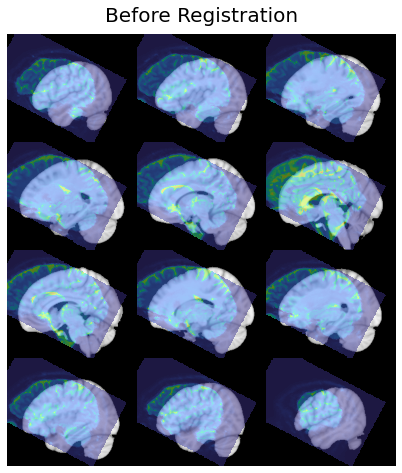

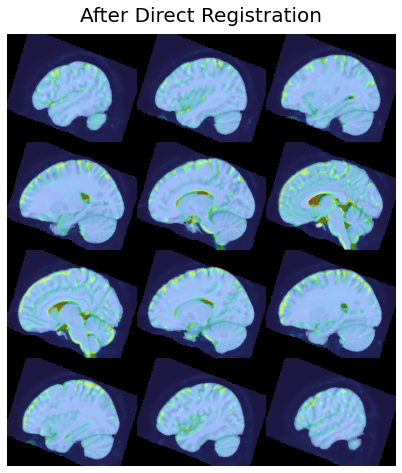

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/mni/MNI1mm_sub-006_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/mni/MNI1mm_sub-006_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/mni/MNI1mm_sub-006_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/mni/MNI1mm_sub-006_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

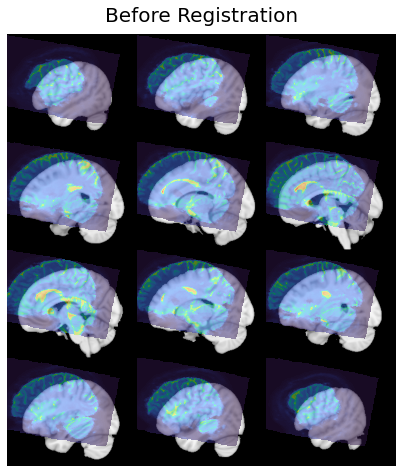

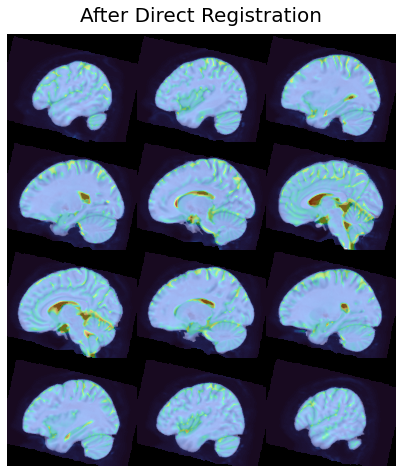

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-008/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-008/mni/MNI1mm_sub-008_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-008/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-008/mni/MNI1mm_sub-008_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-008/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-008/mni/MNI1mm_sub-008_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-008/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-008/mni/MNI1mm_sub-008_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

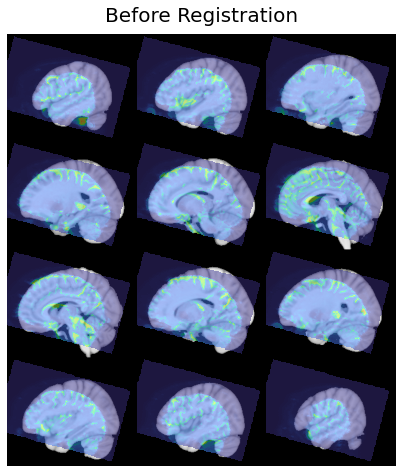

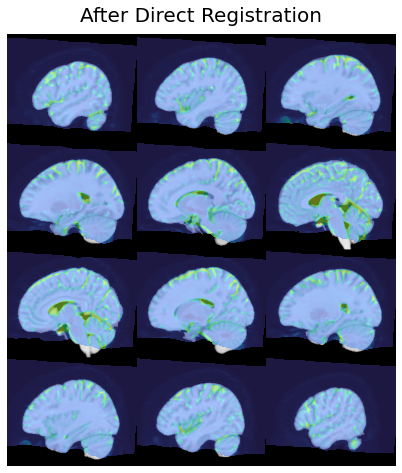

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/mni/MNI1mm_sub-009_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/mni/MNI1mm_sub-009_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/mni/MNI1mm_sub-009_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/mni/MNI1mm_sub-009_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

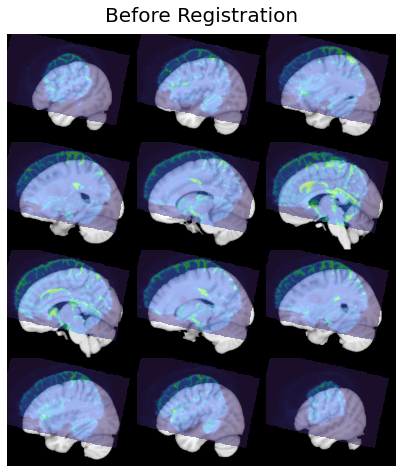

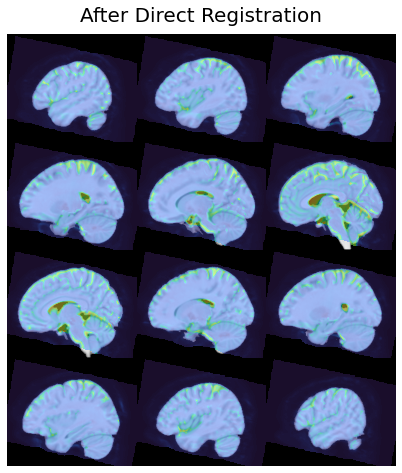

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-010/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-010/mni/MNI1mm_sub-010_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-010/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-010/mni/MNI1mm_sub-010_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-010/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-010/mni/MNI1mm_sub-010_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-010/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-010/mni/MNI1mm_sub-010_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

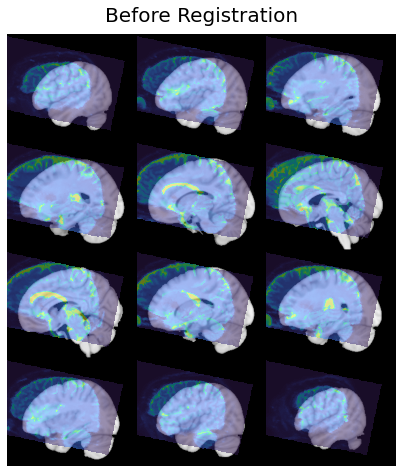

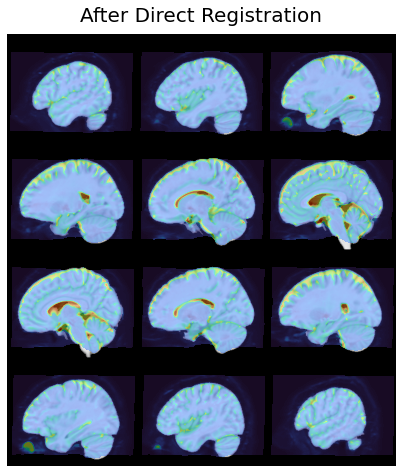

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/mni/MNI1mm_sub-011_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/mni/MNI1mm_sub-011_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/mni/MNI1mm_sub-011_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/mni/MNI1mm_sub-011_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

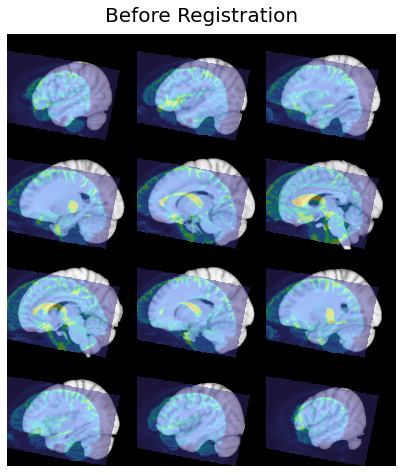

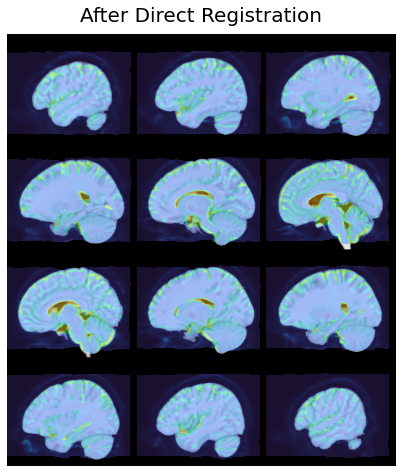

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/mni/MNI1mm_sub-012_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/mni/MNI1mm_sub-012_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/mni/MNI1mm_sub-012_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/mni/MNI1mm_sub-012_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

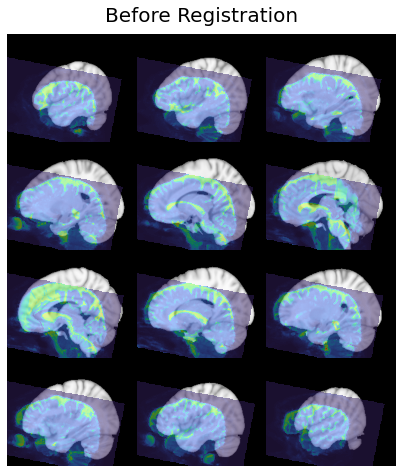

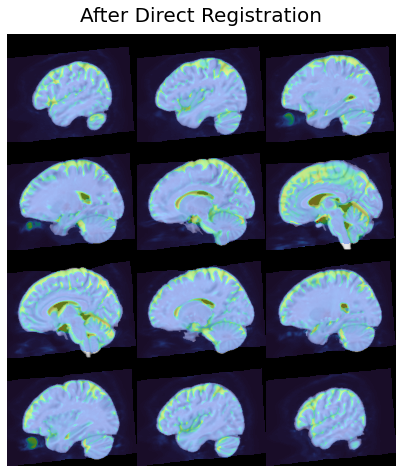

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-013/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-013/mni/MNI1mm_sub-013_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-013/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-013/mni/MNI1mm_sub-013_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-013/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-013/mni/MNI1mm_sub-013_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-013/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-013/mni/MNI1mm_sub-013_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

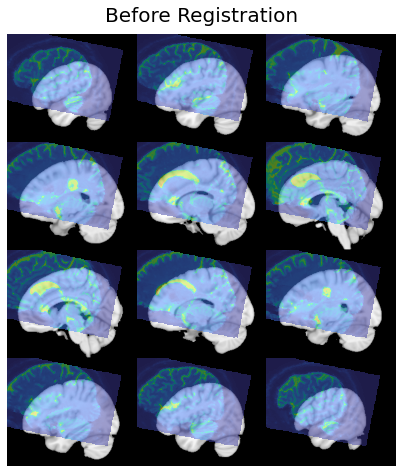

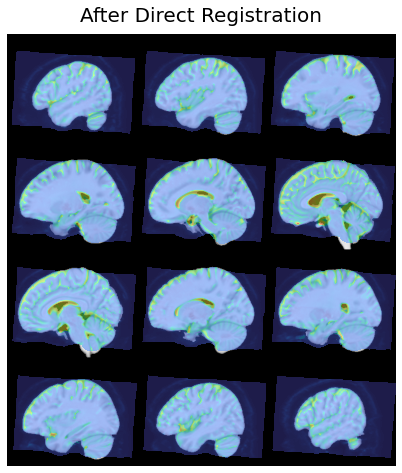

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-014/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-014/mni/MNI1mm_sub-014_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-014/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-014/mni/MNI1mm_sub-014_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-014/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-014/mni/MNI1mm_sub-014_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-014/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-014/mni/MNI1mm_sub-014_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

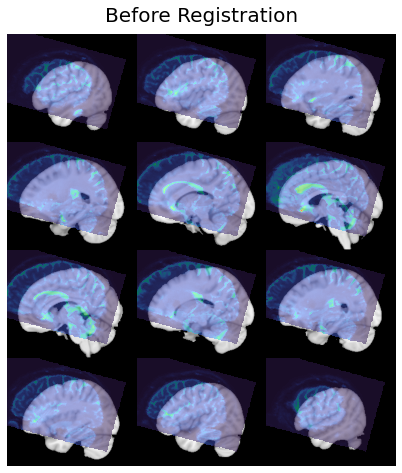

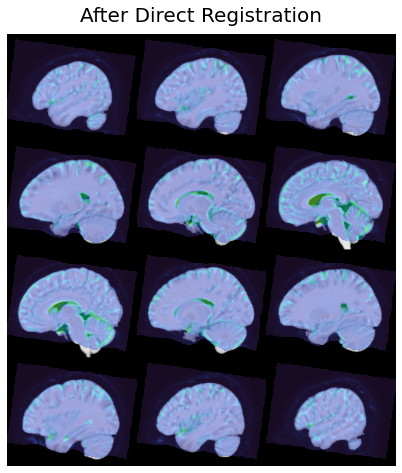

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/mni/MNI1mm_sub-015_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/mni/MNI1mm_sub-015_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/mni/MNI1mm_sub-015_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/mni/MNI1mm_sub-015_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

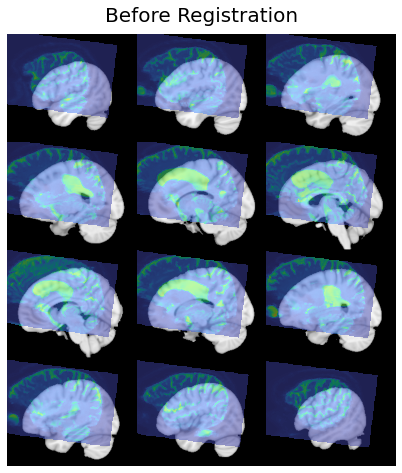

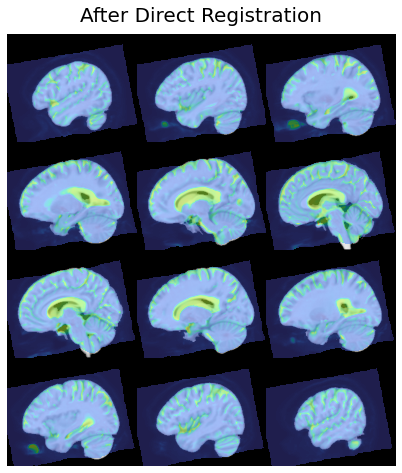

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/mni/MNI1mm_sub-016_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/mni/MNI1mm_sub-016_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/mni/MNI1mm_sub-016_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/mni/MNI1mm_sub-016_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

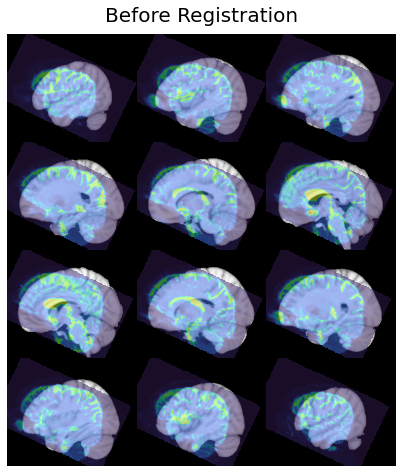

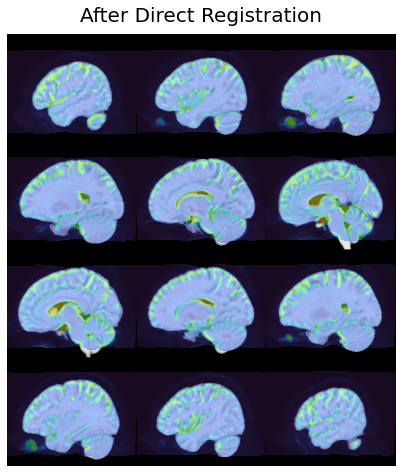

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-017/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-017/mni/MNI1mm_sub-017_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-017/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-017/mni/MNI1mm_sub-017_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-017/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-017/mni/MNI1mm_sub-017_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-017/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-017/mni/MNI1mm_sub-017_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

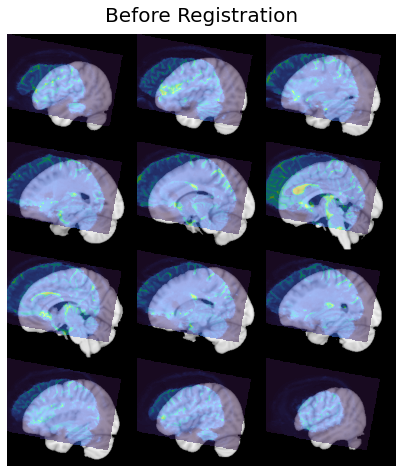

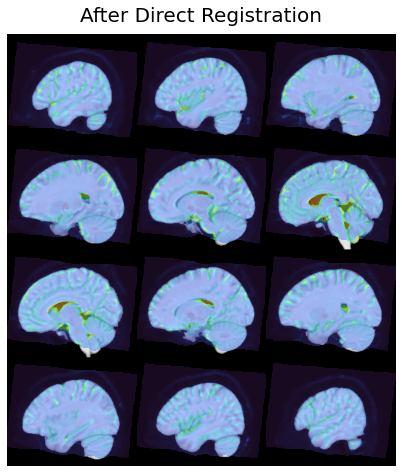

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/mni/MNI1mm_sub-018_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/mni/MNI1mm_sub-018_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/mni/MNI1mm_sub-018_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/mni/MNI1mm_sub-018_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

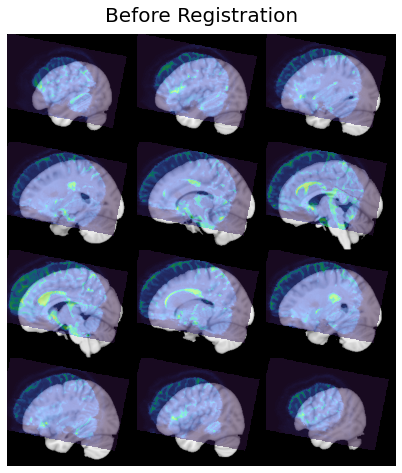

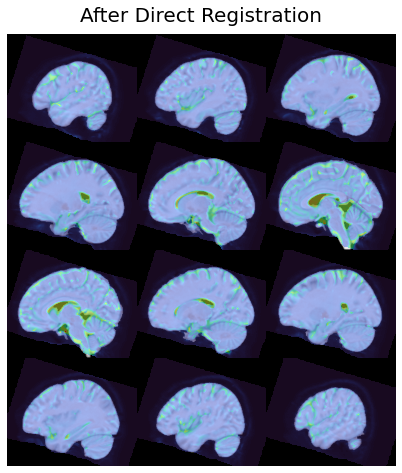

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/mni/MNI1mm_sub-020_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/mni/MNI1mm_sub-020_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/mni/MNI1mm_sub-020_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/mni/MNI1mm_sub-020_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

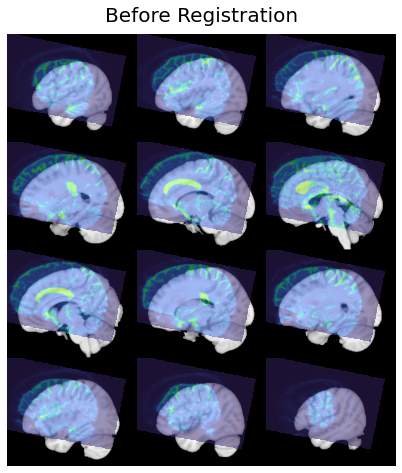

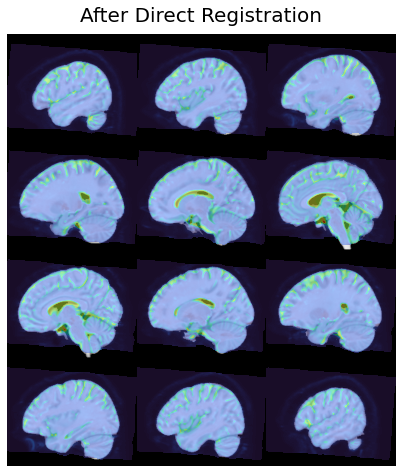

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-022/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-022/mni/MNI1mm_sub-022_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-022/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-022/mni/MNI1mm_sub-022_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-022/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-022/mni/MNI1mm_sub-022_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-022/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-022/mni/MNI1mm_sub-022_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

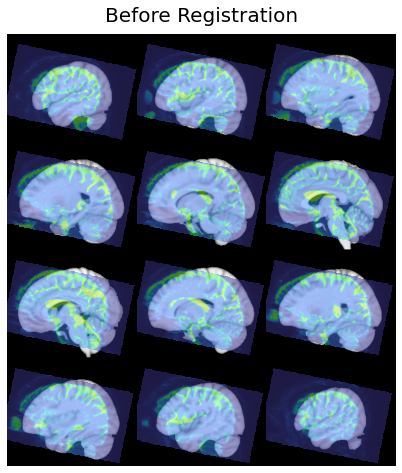

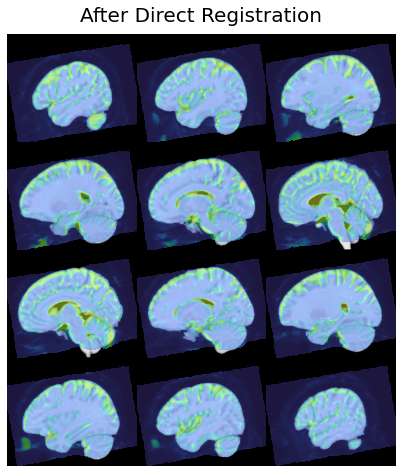

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-023/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-023/mni/MNI1mm_sub-023_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-023/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-023/mni/MNI1mm_sub-023_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-023/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-023/mni/MNI1mm_sub-023_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-023/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-023/mni/MNI1mm_sub-023_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

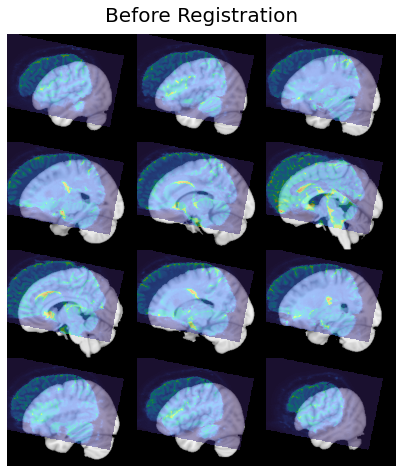

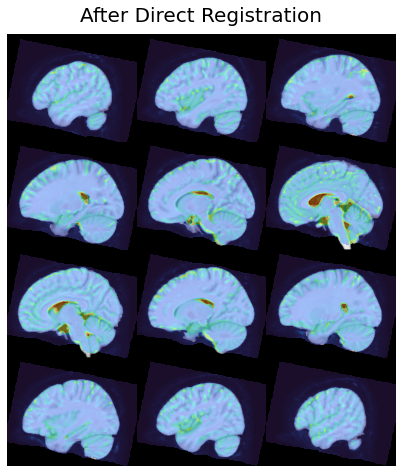

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/mni/MNI1mm_sub-025_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/mni/MNI1mm_sub-025_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/mni/MNI1mm_sub-025_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/mni/MNI1mm_sub-025_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

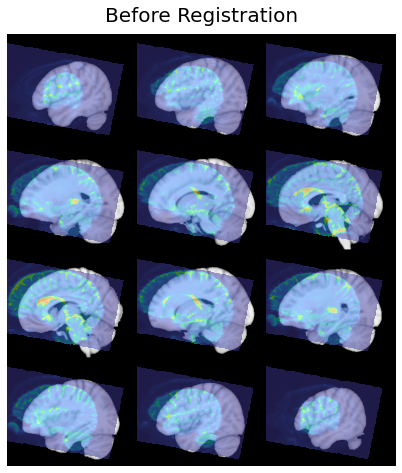

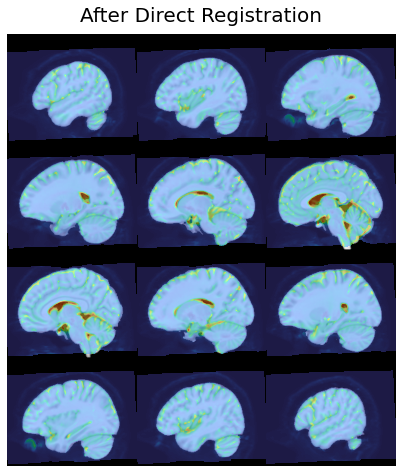

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-031/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-031/mni/MNI1mm_sub-031_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-031/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-031/mni/MNI1mm_sub-031_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-031/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-031/mni/MNI1mm_sub-031_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-031/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-031/mni/MNI1mm_sub-031_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

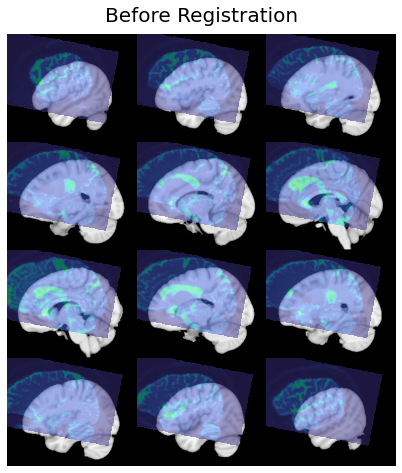

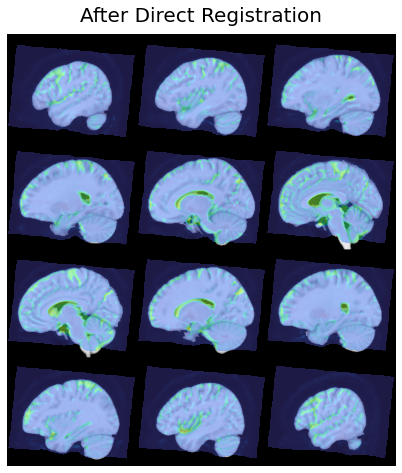

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-032/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-032/mni/MNI1mm_sub-032_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-032/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-032/mni/MNI1mm_sub-032_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-032/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-032/mni/MNI1mm_sub-032_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-032/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-032/mni/MNI1mm_sub-032_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

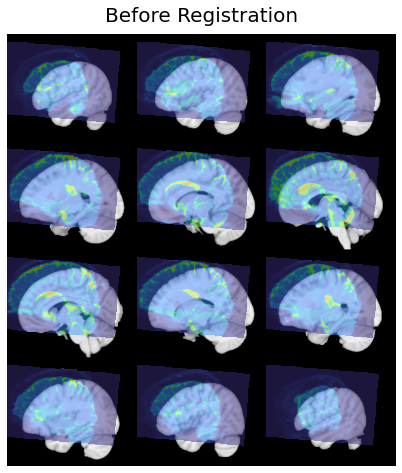

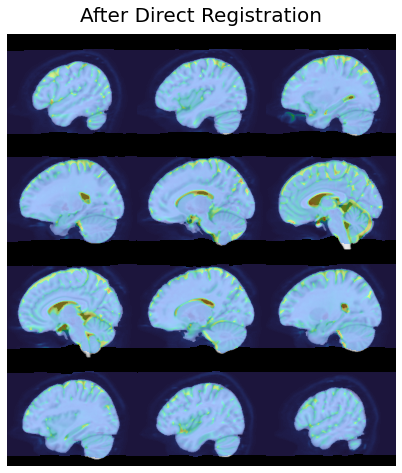

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/mni/MNI1mm_sub-033_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/mni/MNI1mm_sub-033_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/mni/MNI1mm_sub-033_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/mni/MNI1mm_sub-033_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

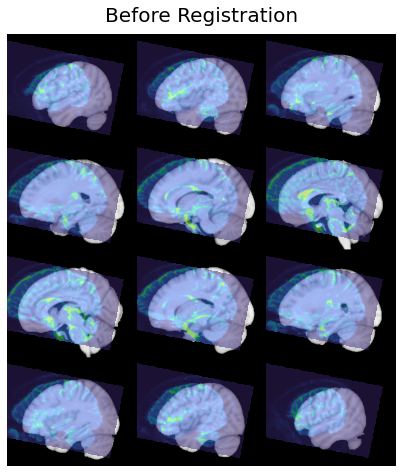

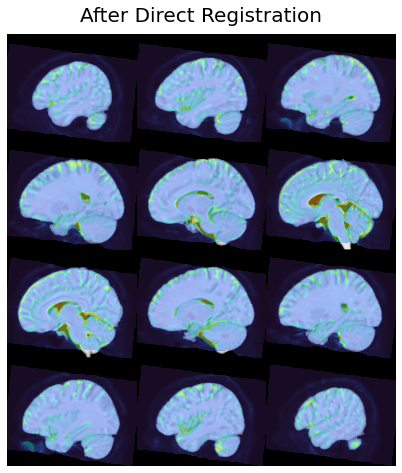

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/mni/MNI1mm_sub-040_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/mni/MNI1mm_sub-040_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/mni/MNI1mm_sub-040_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/mni/MNI1mm_sub-040_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

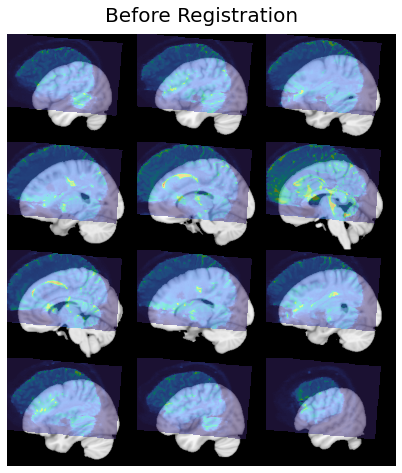

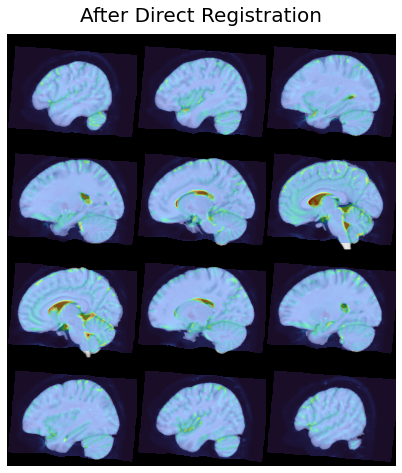

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/mni/MNI1mm_sub-041_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/mni/MNI1mm_sub-041_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/mni/MNI1mm_sub-041_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/mni/MNI1mm_sub-041_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

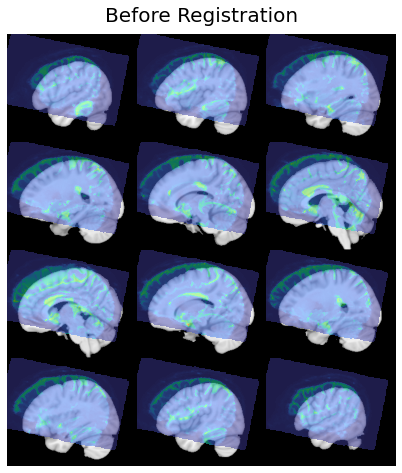

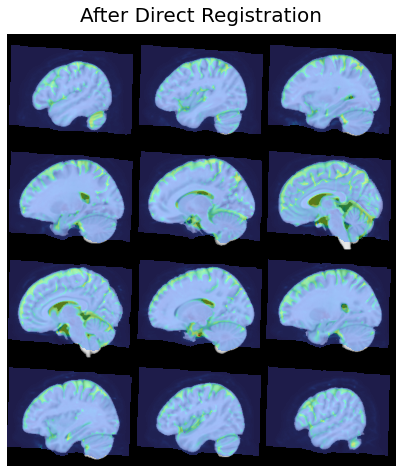

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/mni/MNI1mm_sub-044_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/mni/MNI1mm_sub-044_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/mni/MNI1mm_sub-044_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/mni/MNI1mm_sub-044_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

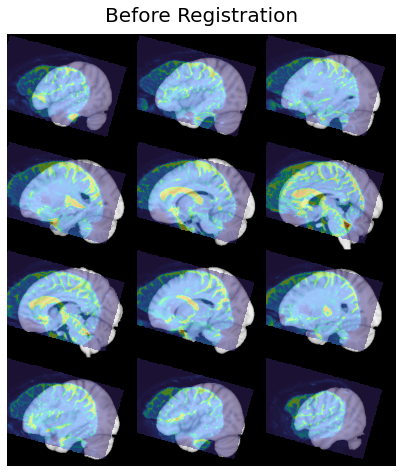

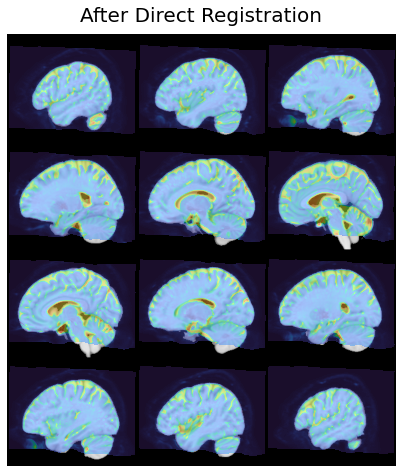

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/mni/MNI1mm_sub-047_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/mni/MNI1mm_sub-047_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/mni/MNI1mm_sub-047_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/mni/MNI1mm_sub-047_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

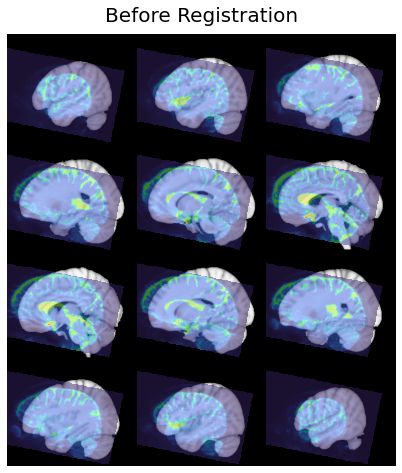

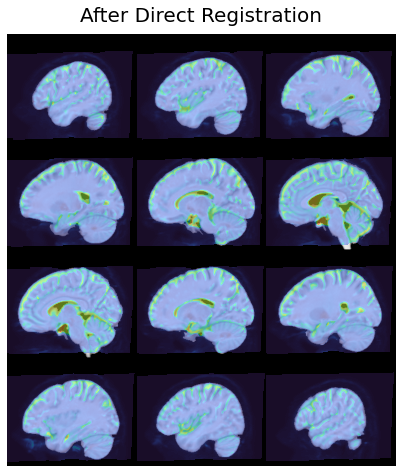

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-048/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-048/mni/MNI1mm_sub-048_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-048/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-048/mni/MNI1mm_sub-048_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-048/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-048/mni/MNI1mm_sub-048_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-048/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-048/mni/MNI1mm_sub-048_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

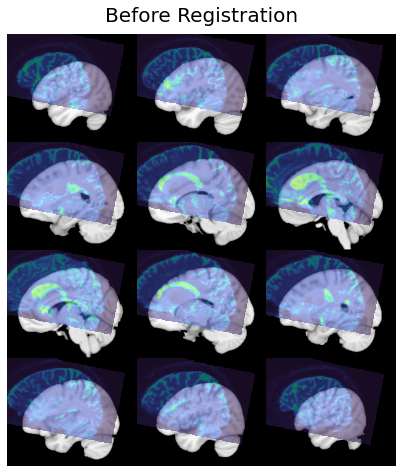

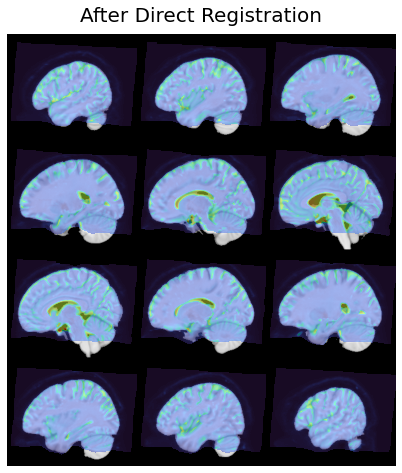

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/mni/MNI1mm_sub-053_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/mni/MNI1mm_sub-053_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/mni/MNI1mm_sub-053_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/mni/MNI1mm_sub-053_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

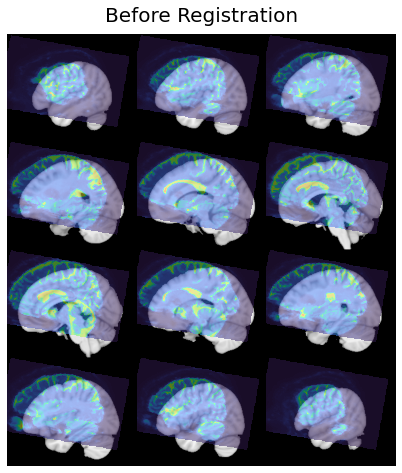

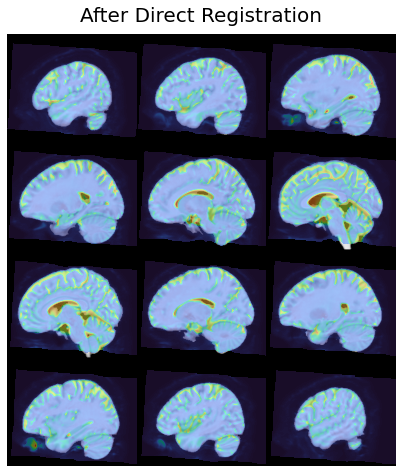

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/mni/MNI1mm_sub-054_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/mni/MNI1mm_sub-054_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/mni/MNI1mm_sub-054_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/mni/MNI1mm_sub-054_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

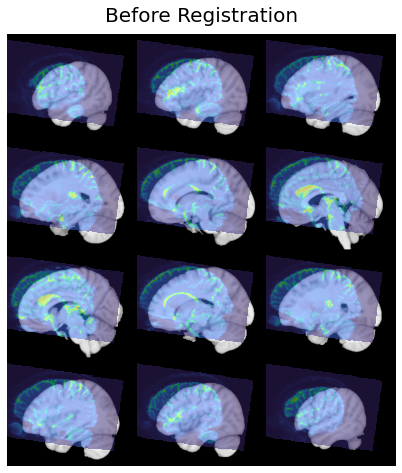

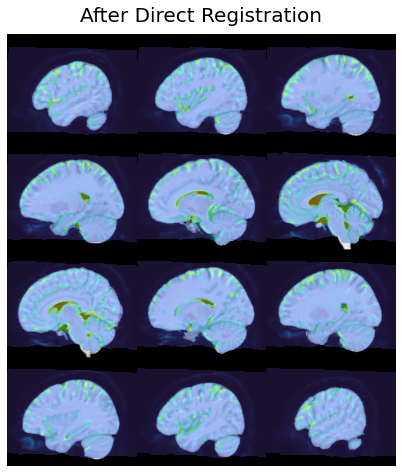

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-056/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-056/mni/MNI1mm_sub-056_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-056/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-056/mni/MNI1mm_sub-056_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-056/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-056/mni/MNI1mm_sub-056_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-056/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-056/mni/MNI1mm_sub-056_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

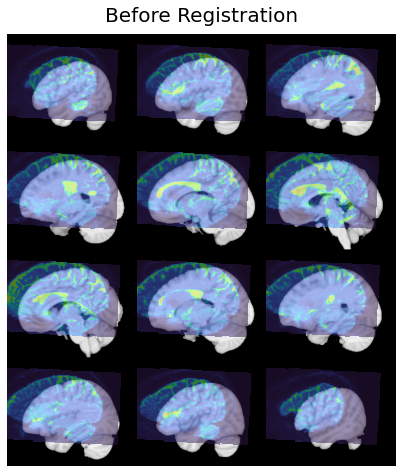

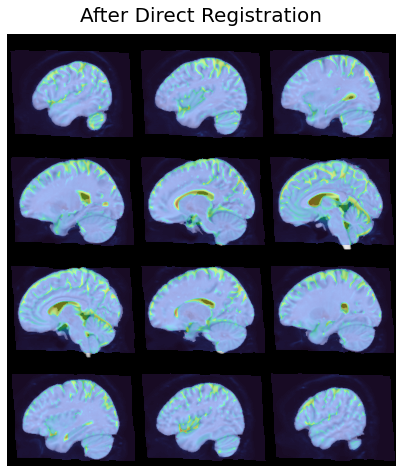

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/mni/MNI1mm_sub-058_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/mni/MNI1mm_sub-058_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/mni/MNI1mm_sub-058_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/mni/MNI1mm_sub-058_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

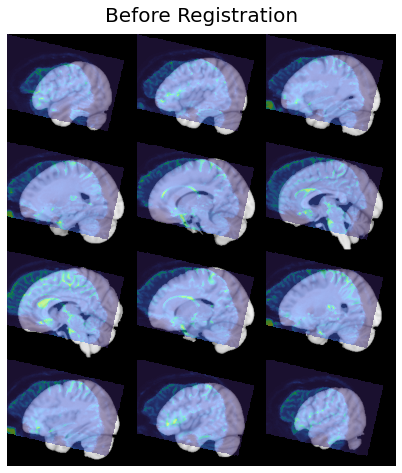

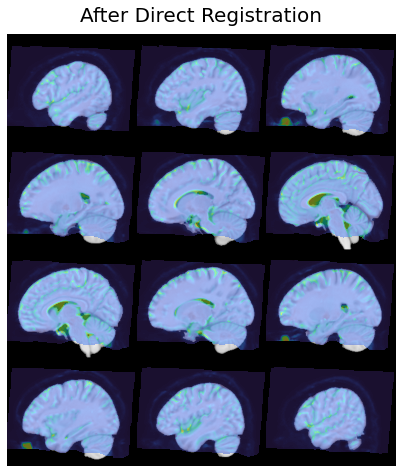

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/mni/MNI1mm_sub-059_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/mni/MNI1mm_sub-059_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/mni/MNI1mm_sub-059_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/mni/MNI1mm_sub-059_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

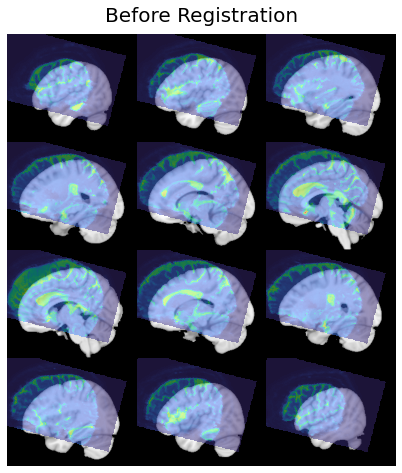

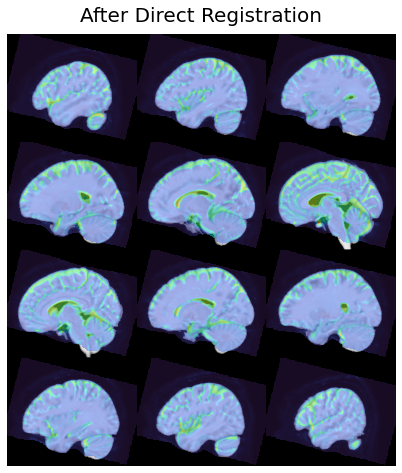

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-060/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-060/mni/MNI1mm_sub-060_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-060/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-060/mni/MNI1mm_sub-060_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-060/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-060/mni/MNI1mm_sub-060_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-060/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-060/mni/MNI1mm_sub-060_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

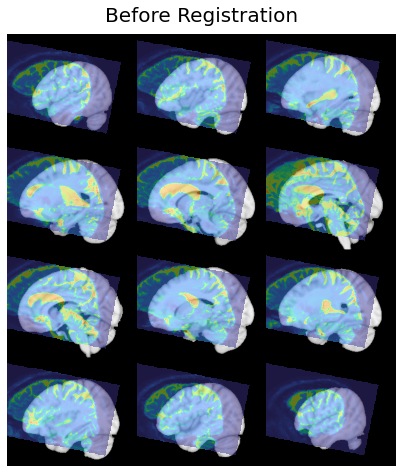

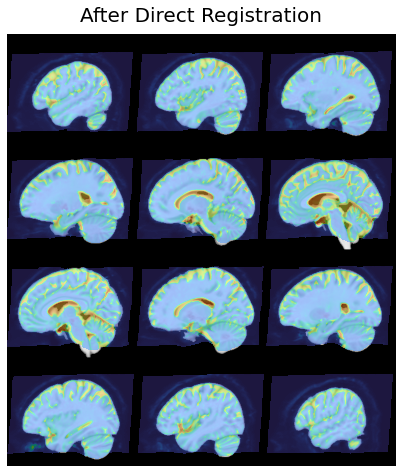

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/mni/MNI1mm_sub-062_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/mni/MNI1mm_sub-062_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/mni/MNI1mm_sub-062_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/mni/MNI1mm_sub-062_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

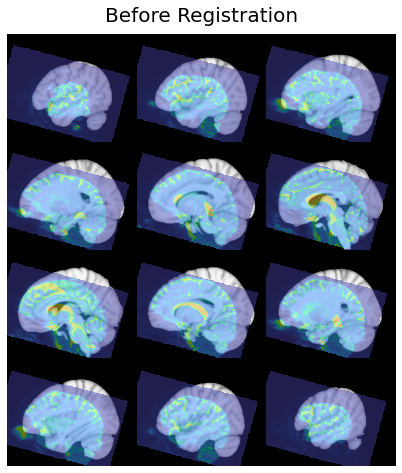

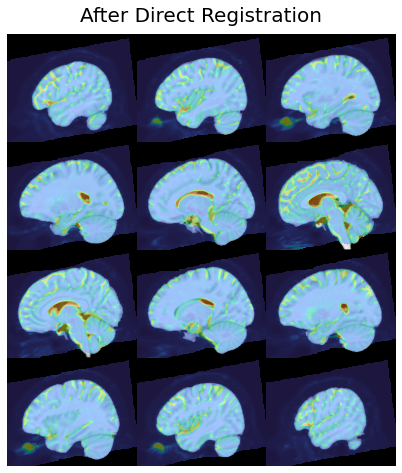

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/mni/MNI1mm_sub-063_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/mni/MNI1mm_sub-063_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/mni/MNI1mm_sub-063_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/mni/MNI1mm_sub-063_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

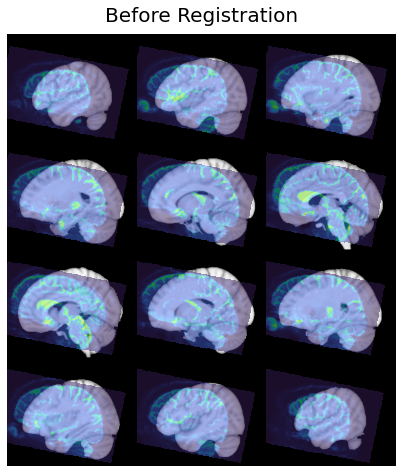

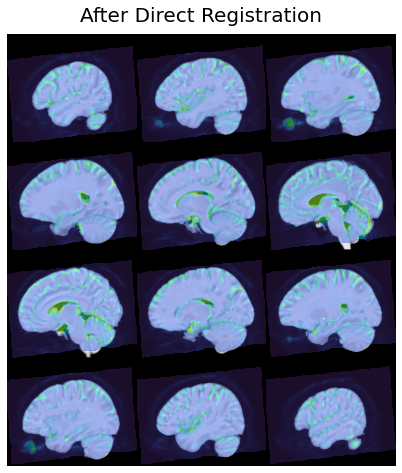

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/mni/MNI1mm_sub-064_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/mni/MNI1mm_sub-064_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/mni/MNI1mm_sub-064_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/mni/MNI1mm_sub-064_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

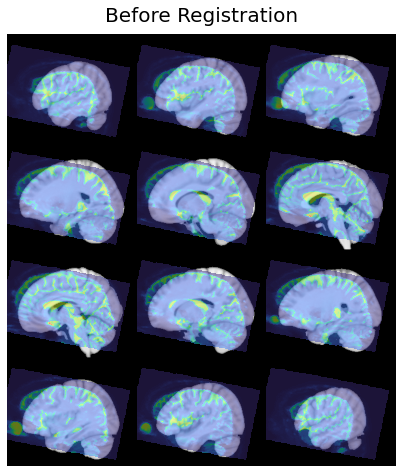

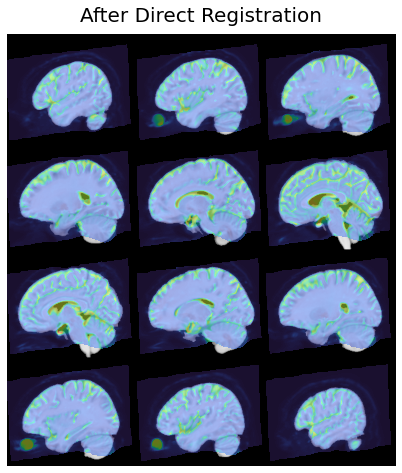

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-065/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-065/mni/MNI1mm_sub-065_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-065/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-065/mni/MNI1mm_sub-065_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-065/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-065/mni/MNI1mm_sub-065_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-065/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-065/mni/MNI1mm_sub-065_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

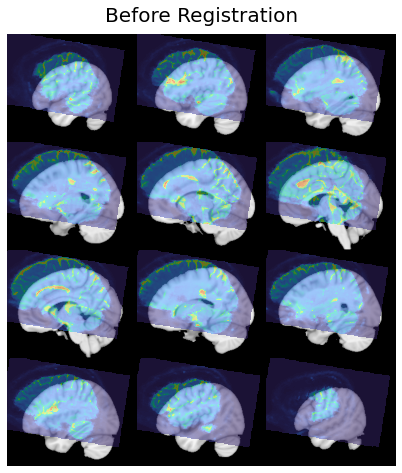

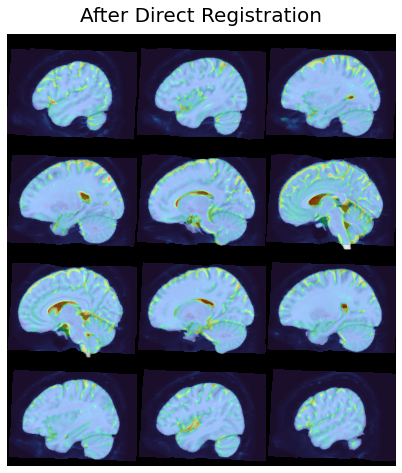

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/mni/MNI1mm_sub-069_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/mni/MNI1mm_sub-069_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/mni/MNI1mm_sub-069_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/mni/MNI1mm_sub-069_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

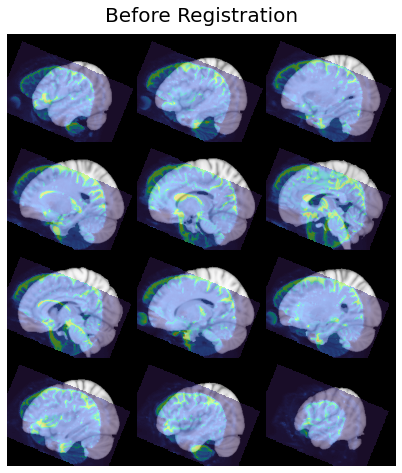

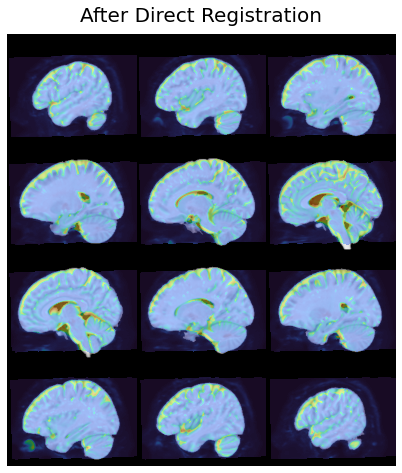

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/mni/MNI1mm_sub-070_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/mni/MNI1mm_sub-070_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/mni/MNI1mm_sub-070_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/mni/MNI1mm_sub-070_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

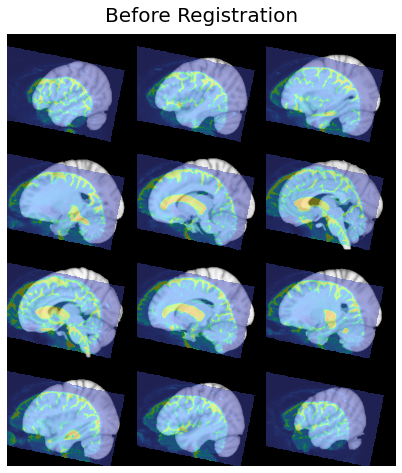

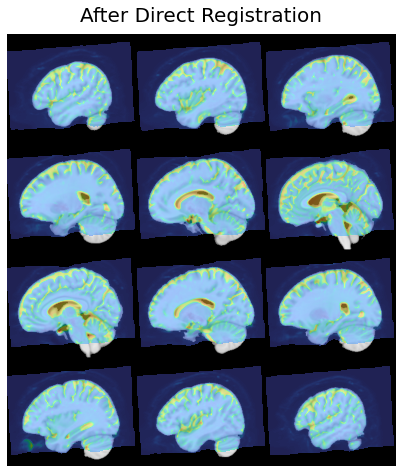

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-071/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-071/mni/MNI1mm_sub-071_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-071/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-071/mni/MNI1mm_sub-071_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-071/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-071/mni/MNI1mm_sub-071_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-071/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-071/mni/MNI1mm_sub-071_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

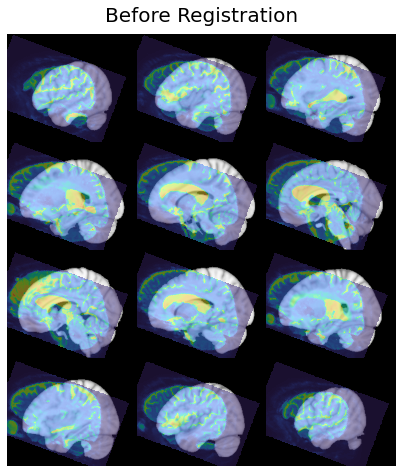

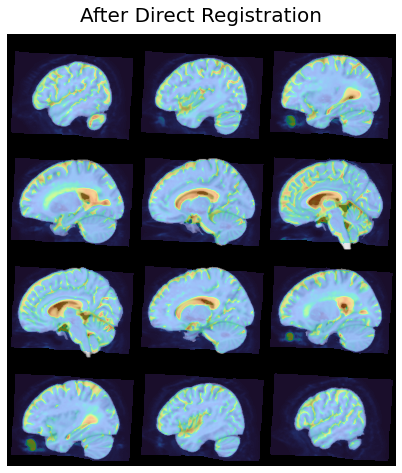

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/mni/MNI1mm_sub-074_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/mni/MNI1mm_sub-074_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/mni/MNI1mm_sub-074_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/mni/MNI1mm_sub-074_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

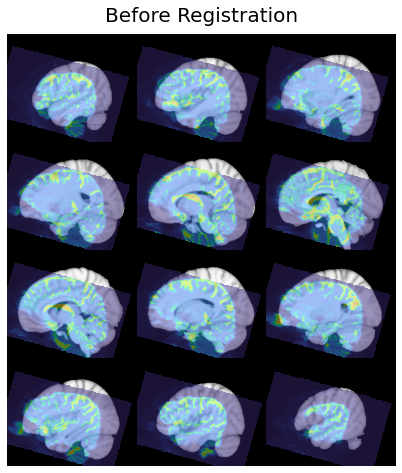

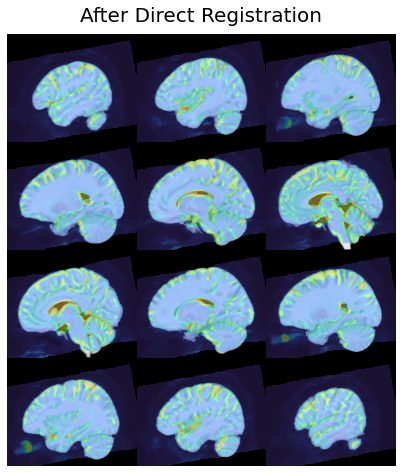

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/mni/MNI1mm_sub-078_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/mni/MNI1mm_sub-078_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/mni/MNI1mm_sub-078_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/mni/MNI1mm_sub-078_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

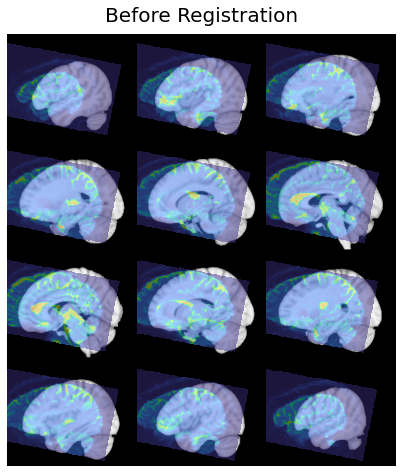

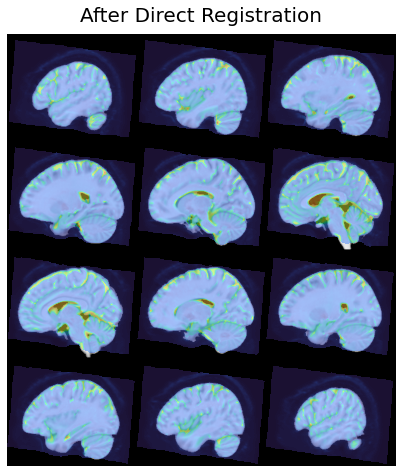

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/mni/MNI1mm_sub-082_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/mni/MNI1mm_sub-082_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/mni/MNI1mm_sub-082_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/mni/MNI1mm_sub-082_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

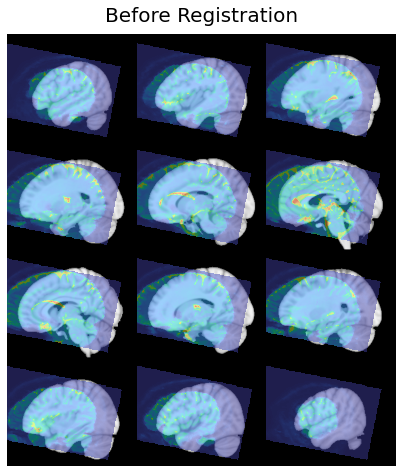

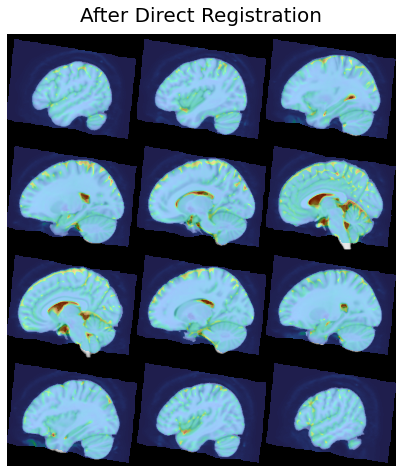

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/mni/MNI1mm_sub-083_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/mni/MNI1mm_sub-083_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/mni/MNI1mm_sub-083_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/mni/MNI1mm_sub-083_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

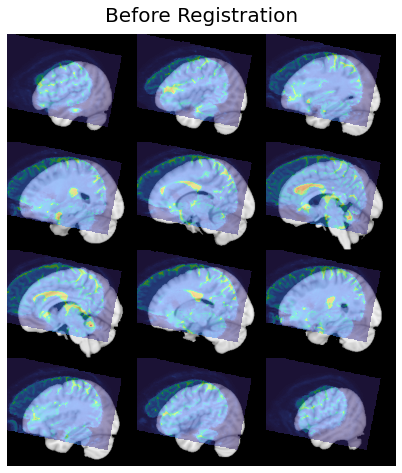

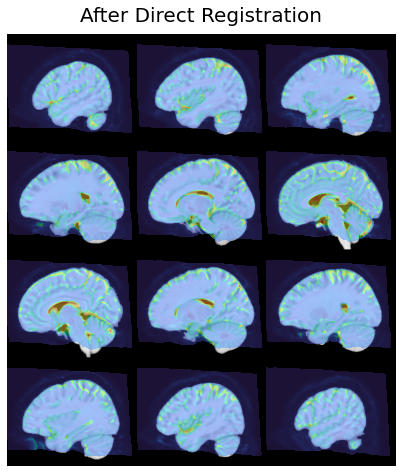

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/mni/MNI1mm_sub-084_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/mni/MNI1mm_sub-084_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/mni/MNI1mm_sub-084_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/mni/MNI1mm_sub-084_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

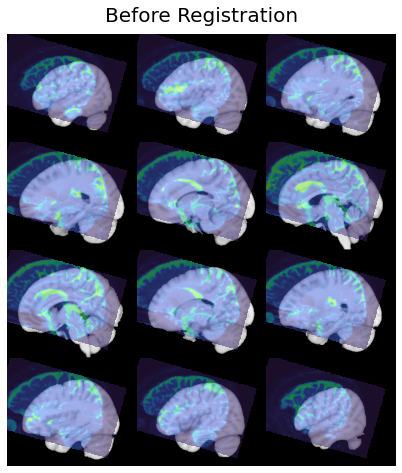

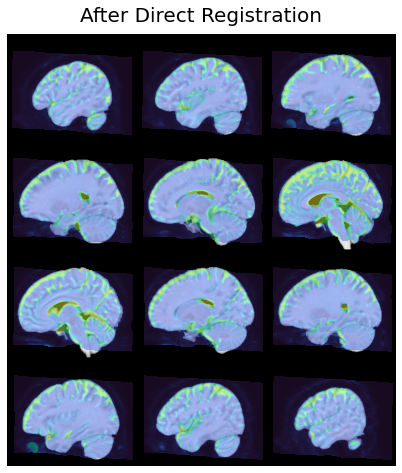

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-086/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-086/mni/MNI1mm_sub-086_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-086/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-086/mni/MNI1mm_sub-086_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-086/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-086/mni/MNI1mm_sub-086_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-086/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-086/mni/MNI1mm_sub-086_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

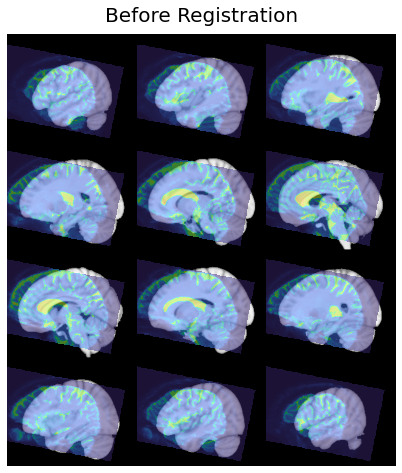

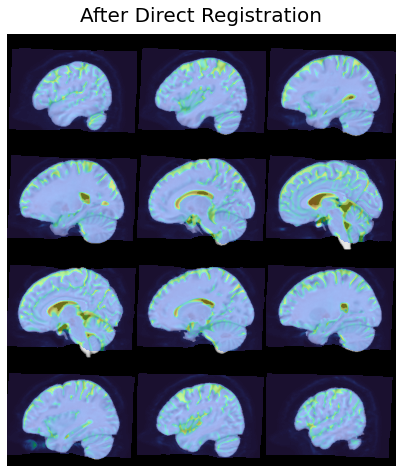

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/mni/MNI1mm_sub-089_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/mni/MNI1mm_sub-089_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/mni/MNI1mm_sub-089_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/mni/MNI1mm_sub-089_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

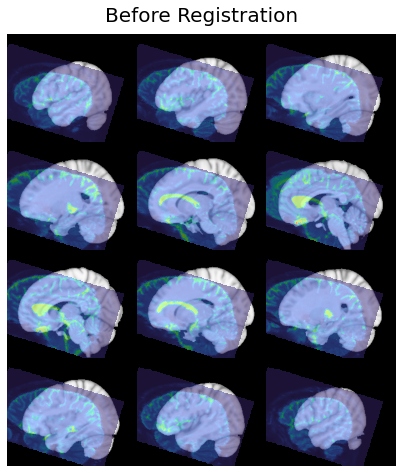

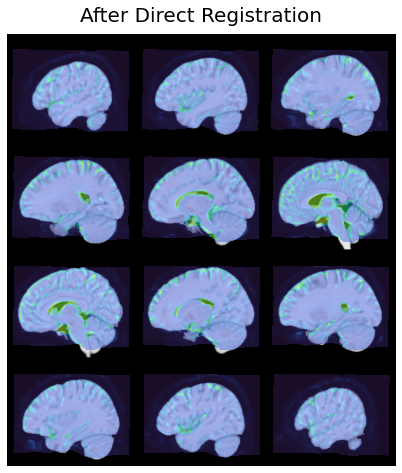

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/mni/MNI1mm_sub-090_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/mni/MNI1mm_sub-090_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/mni/MNI1mm_sub-090_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/mni/MNI1mm_sub-090_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

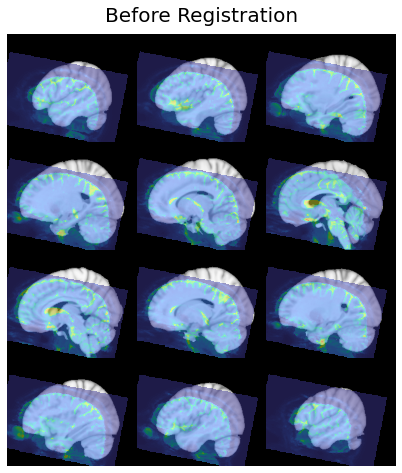

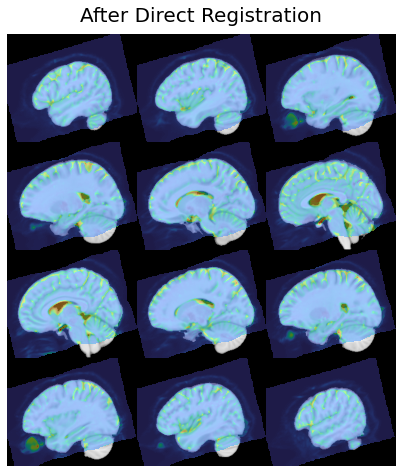

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/mni/MNI1mm_sub-091_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/mni/MNI1mm_sub-091_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/mni/MNI1mm_sub-091_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/mni/MNI1mm_sub-091_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

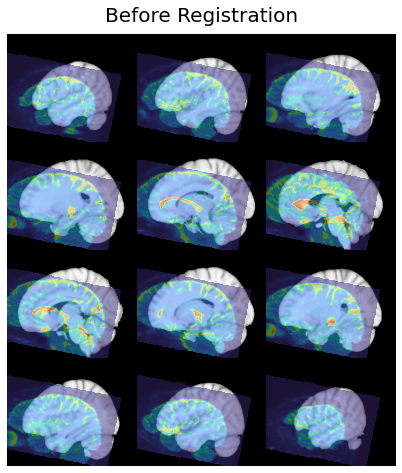

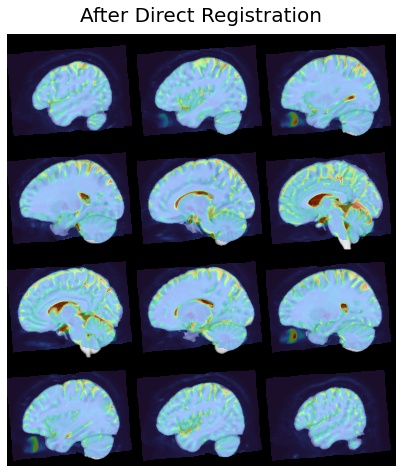

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-095/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-095/mni/MNI1mm_sub-095_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-095/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-095/mni/MNI1mm_sub-095_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-095/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-095/mni/MNI1mm_sub-095_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-095/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-095/mni/MNI1mm_sub-095_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

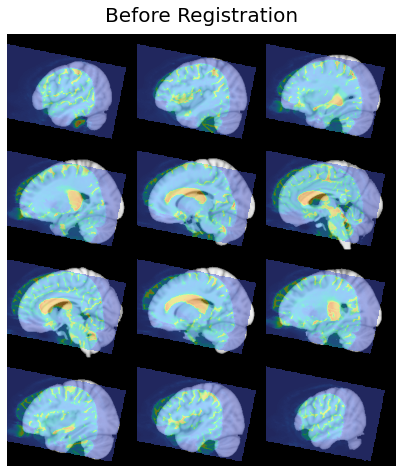

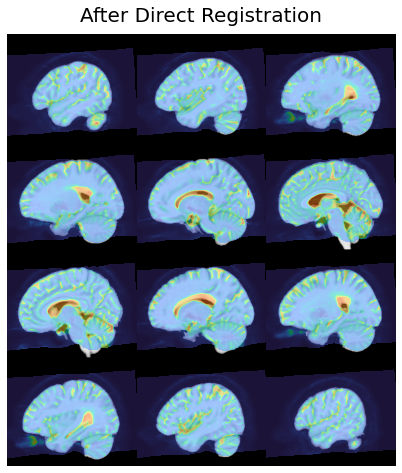

/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-103/tck-weighted/egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-103/mni/MNI1mm_sub-103_egde-1-3.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-103/tck-weighted/egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-103/mni/MNI1mm_sub-103_egde-2-4.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-103/tck-weighted/egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-103/mni/MNI1mm_sub-103_egde-1-5.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-103/tck-weighted/egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-103/mni/MNI1mm_sub-103_egde-2-6.nii.gz
/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz
/home/public/StoppingAge-DWI

In [6]:
#################################################################################
## 10) Code to register the mean TCK streamlines to MNI
#################################################################################
overwrite = True

for subject in subjects:
    print(subject+' - generate nii track images in B0 space + B0 to MNI')
    
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    preprocessed_dir = work_dir+'/preprocessed'
    tract_dir = work_dir+'/connectome2tck'
    mni_dir = work_dir+'/mni'
    weighted_dir = work_dir+'/tck-weighted'
    
    # Create the output folder
    if ((os.path.exists(mni_dir)) & (overwrite == False)):
        print('\nTracks already generated and mean B0 registered to MNI (set overwrite to True to recompute)')
    else:
        print('\nGenerate track-weighted files in individual space and register mean B0 to MNI space')
        os.makedirs(mni_dir, exist_ok=True)
        os.makedirs(weighted_dir, exist_ok=True)

        # Location of the MNI template and masks data:
        mniTemplate1mmBrain = '/home/public/StoppingAge-DWI-Ahead/Data/Atlases/MNI152_T1_1mm_brain.nii.gz'
        STN_IFG_L_tck = tract_dir+'/egde-1-3.tck'
        STN_IFG_R_tck = tract_dir+'/egde-2-4.tck'
        STN_preSMA_L_tck = tract_dir+'/egde-1-5.tck'
        STN_preSMA_R_tck = tract_dir+'/egde-2-6.tck'
        IFG_preSMA_L_tck = tract_dir+'/egde-3-5.tck'
        IFG_preSMA_R_tck = tract_dir+'/egde-4-6.tck'
        
        STN_IFG_L_nii = weighted_dir+'/egde-1-3.nii.gz'
        STN_IFG_R_nii = weighted_dir+'/egde-2-4.nii.gz'
        STN_preSMA_L_nii = weighted_dir+'/egde-1-5.nii.gz'
        STN_preSMA_R_nii = weighted_dir+'/egde-2-6.nii.gz'
        IFG_preSMA_L_nii = weighted_dir+'/egde-3-5.nii.gz'
        IFG_preSMA_R_nii = weighted_dir+'/egde-4-6.nii.gz'
        
        tracts_tck = [STN_IFG_L_tck, STN_IFG_R_tck, STN_preSMA_L_tck, STN_preSMA_R_tck, IFG_preSMA_L_tck, IFG_preSMA_R_tck]
        tracts_nii = [STN_IFG_L_nii, STN_IFG_R_nii, STN_preSMA_L_nii, STN_preSMA_R_nii, IFG_preSMA_L_nii, IFG_preSMA_R_nii]
        
        # Assign Mean B0 to variable:    
        meanB0Image = preprocessed_dir+'/mean_b0.nii.gz'
        
        # Transform the TCK files to nii.gz format
        for i in range(0, len(tracts_tck)):
            command =  'tckmap -template '+meanB0Image+' '+tracts_tck[i]+' '+tracts_nii[i]+' -force'
            print(command)
            try:
                 subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
            except subprocess.CalledProcessError as e:
                msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
                raise subprocess.CalledProcessError(msg)
        
        # Register the B0 to MNI space and apply it to the tracts
        # 1) Determine the transformation fields
        registrationSteps = [1, 2]
        for registrationStep in registrationSteps:
            if registrationStep == 1:
                fixed = ants.image_read(mniTemplate1mmBrain)
                moving = ants.image_read(meanB0Image)

                #fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
                mytx1 = ants.registration(fixed = fixed , moving = moving, type_of_transform = 'SyN', write_composite_transform = True)
                warped_moving = mytx1['warpedmovout']
                #fixed.plot(overlay = warped_moving, title = 'After First Registration', overlay_alpha = 0.5)

            if registrationStep == 2:
                fixed = ants.image_read(mniTemplate1mmBrain)
                moving = mytx1['warpedmovout']

                #fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
                mytx2 = ants.registration(fixed = fixed, moving = moving, type_of_transform = 'SyNAggro', write_composite_transform = True)
                warped_moving = mytx2['warpedmovout']
                #fixed.plot(overlay = warped_moving, title = 'After Second Registration', overlay_alpha = 0.5)

        # Check if the direct registration worked
        fixed = ants.image_read(mniTemplate1mmBrain)
        moving = ants.image_read(meanB0Image)

        fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
        warpedimage = ants.apply_transforms(fixed=fixed, moving=moving, transformlist=[mytx1['fwdtransforms'], mytx2['fwdtransforms']])
        fixed.plot(overlay = warpedimage, title = 'After Direct Registration', overlay_alpha = 0.5)

        # 2) Apply the two transformation fields to the MNI masks
        for mask in tracts_nii:
            print(mask)
            inputMask = mask
            #outputName = 'MNI1mm_'+inputMask.split('/')[-1]
            outputImageName = mni_dir+'/MNI1mm_'+subject+'_'+inputMask.split('/')[-1]
            print(outputImageName)
            fixed = ants.image_read(mniTemplate1mmBrain)
            moving = ants.image_read(inputMask)
            print(mniTemplate1mmBrain)
            #fixed.plot(overlay = moving, title = 'Before Registration', overlay_alpha = 0.5)
            warpedimage = ants.apply_transforms(fixed=fixed, moving=moving, transformlist=[mytx1['fwdtransforms'], mytx2['fwdtransforms']])
            #fixed.plot(overlay = warpedimage, title = 'After Registration', overlay_alpha = 0.5)

            # 3) Save the ants image to nifti
            # Export the ANTSimage to a nifti via nibabel
            fixedNibabel = ants.to_nibabel(fixed)
            warpedimageNibabel = ants.to_nibabel(warpedimage)
            # Where I need to copy the affine matrix of the B0 image because the warpfield does something weird with the matrix
            #. which then interfers with mrview
            mask2Nifti = warpedimageNibabel.__class__(warpedimageNibabel.dataobj[:], fixedNibabel.affine, warpedimageNibabel.header)
            mask2Nifti.to_filename(outputImageName)
    

In [10]:
#################################################################################
## 11) Generating FA and MD/MDA images
#################################################################################

# First need to convert the existing FODs from .mif to .nii.gz

def convertMIFs(subject):
    print(subject+'\n')
    
    # Local path settings 
    work_dir = mainProjectFolder+dwiDataFolder+subject
    fod_dir = work_dir+'/dwi2fod/'
    
    fods = ['csffod', 'gmfod', 'wmfod']
    
    for file in fods:        
        command = 'mrconvert -force ' +fod_dir+file+'.mif ' +fod_dir+file+'.nii.gz'
        print(command+'\n')
        
        try:
             subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)

# Run the function 
if __name__ == '__main__':
    pool = Pool(3) 
    pool.map(convertMIFs, subjects) 
    pool.close() 

sub-011
sub-001


mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/dwi2fod/csffod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/dwi2fod/csffod.nii.gz
sub-016
mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/dwi2fod/csffod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/dwi2fod/csffod.nii.gz



mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/dwi2fod/csffod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/dwi2fod/csffod.nii.gz

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/dwi2fod/gmfod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/dwi2fod/gmfod.nii.gz

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/dwi2fod/gmfod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/dwi2fod/gmfod.nii.gz

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/dwi2fod/gmfod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/dwi2fod/gmfod.nii.gz

m


mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/dwi2fod/wmfod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/dwi2fod/wmfod.nii.gz

sub-025

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/dwi2fod/csffod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/dwi2fod/csffod.nii.gz

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/dwi2fod/gmfod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/dwi2fod/gmfod.nii.gz

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/dwi2fod/wmfod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/dwi2fod/wmfod.nii.gz

sub-053

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/dwi2fod/csffod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/dwi2fod/csffod.nii.gz

sub-041

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/dwi2fod/csffod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/dwi2fod/csffod.nii.gz




sub-082

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/dwi2fod/csffod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/dwi2fod/csffod.nii.gz

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/dwi2fod/gmfod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/dwi2fod/gmfod.nii.gz

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/dwi2fod/gmfod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/dwi2fod/gmfod.nii.gz

sub-063

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/dwi2fod/csffod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/dwi2fod/csffod.nii.gz

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/dwi2fod/wmfod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/dwi2fod/wmfod.nii.gz

mrconvert -force /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/dwi2fod/wmfod.mif /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-082/dwi2fod/wmfod.nii.gz

mrconvert -

In [4]:
############
#    FA    #
############

# This creates an FA map using ODFs (or FODs), as opposed to using the traditional diffusion tensor. It is thus 
# better able to take into account crossing fibres. From Tan et al 2014 (doi: 10.1002/jmri.24589) 


overwrite = False 


def generalisedFA(subject):
    print(subject+'\n')
    
    # set directories 
    work_dir = mainProjectFolder+dwiDataFolder+subject
    fod_dir = work_dir+'/dwi2fod'
    
    gfa = fod_dir+'/newFA.nii.gz'
    if ((os.path.exists(gfa)) & (overwrite == False)):
        print('GFA already exists for ' +subject+'\n') 
    else:
        print('Creating GFA for '+subject+'\n')

        # load the wm fod
        wmfod = nib.load(fod_dir+'/wmfod.nii.gz')
    
        fmean = np.mean(np.abs(wmfod.get_fdata()))
        gfa = np.sum(45*(np.abs(wmfod.get_fdata())-fmean)**2,axis=3)/np.maximum(0.00000001,(44*np.sum(wmfod.get_fdata()**2,axis=3)))
        gfa = np.minimum(gfa,1.0)
    
        img = nib.Nifti1Image(gfa,wmfod.affine,wmfod.header)
        nib.save(img, gfa)

      
    
# Run the function 
if __name__ == '__main__':
    pool = Pool(2) 
    pool.map(generalisedFA, subjects) 
    pool.close() 
        
        

sub-013
sub-001


sub-014

sub-006

sub-015

sub-008

sub-009

sub-016

sub-017

sub-010

sub-018

sub-011

sub-020

sub-012

sub-022

sub-041

sub-023

sub-044

sub-025

sub-047

sub-031

sub-048

sub-032

sub-053

sub-033

sub-054

sub-040

sub-056

sub-058

sub-069

sub-059

sub-070

sub-060

sub-071

sub-062

sub-074

sub-063

sub-078

sub-064

sub-082

sub-065

sub-083

sub-084

sub-086

sub-089

sub-090

sub-091

sub-095

sub-103



In [3]:
##############
#     basic ADC   #
##############

# Like with the FA, we wanted to create a more sophisticated estimation of anisotropy than the standard 
# MA that is calculated using a tensor. Calculated by combining the three ODF maps (one each for grey matter, 
# white matter, and CSF). From Volz et al 2018 (doi: 10.1007/s00429-017-1508-x)

# NOTE from Pilou: this ODF component does not measure what I thought it did :(
# We need instead to revert to the classical definition of ADC, based on averaging the dwi data per shell
# and taking ADC = -1/Bval*log(mean_Bval/mean_B0)


overwrite = False 


def createBasicADC(subject):
   
    #local path settings 
    work_dir = mainProjectFolder+dwiDataFolder+subject
    dwi_dir = work_dir+'/preprocessed'
    fod_dir = work_dir+'/dwi2fod'
    
    # ADC file location - check if this exists first, and create it if not 
    adc = fod_dir+'/adc.nii.gz'

    if ((os.path.exists(adc)) & (overwrite == False)):
        print('Basic ADC already exists for ' +subject+'\n') 
    else:
        print('Creating basic ADC for '+subject+'\n')
        
        dwi_img = dwi_dir+'/'+subject+'_ses-3_dwi-preproc.mif.gz'
        # compute the average for each shell
        b0_img = fod_dir+'/'+subject+'mean_b0.nii.gz'
        command =  'dwiextract '+dwi_img+' - -shells 0 | mrmath - mean '+b0_img+' -axis 3 -force'
        print(command)
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)# get the three FOD files 
        
        b700_img = fod_dir+'/'+subject+'mean_b700.nii.gz'
        command =  'dwiextract '+dwi_img+' - -shells 700 | mrmath - mean '+b700_img+' -axis 3 -force'
        print(command)
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)# get the three FOD files 
        
        b1000_img = fod_dir+'/'+subject+'mean_b1000.nii.gz'
        command =  'dwiextract '+dwi_img+' - -shells 1000 | mrmath - mean '+b1000_img+' -axis 3 -force'
        print(command)
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)# get the three FOD files 
        
        b1600_img = fod_dir+'/'+subject+'mean_b1600.nii.gz'
        command =  'dwiextract '+dwi_img+' - -shells 1600 | mrmath - mean '+b1600_img+' -axis 3 -force'
        print(command)
        try:
            subprocess.check_output(command, shell=True, stderr=subprocess.STDOUT)
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)# get the three FOD files 
        
        b0 = nib.load(b0_img)
        b700 = nib.load(b700_img)
        b1000 = nib.load(b1000_img)
        b1600 = nib.load(b1600_img)
        
        # now take the first volume of each and combine them 
        adc = (-1.0/700.0*np.log(b700.get_fdata()/b0.get_fdata(),where=(b700.get_fdata()*b0.get_fdata()>0)) \
               -1.0/1000.0*np.log(b1000.get_fdata()/b0.get_fdata(),where=(b1000.get_fdata()*b0.get_fdata()>0)) \
               -1.0/1600.0*np.log(b1600.get_fdata()/b0.get_fdata(),where=(b1600.get_fdata()*b0.get_fdata()>0)) \
              )/3.0
        
        # save the new file with affine and header info and save
        img = nib.Nifti1Image(adc,b0.affine,b0.header) 
        nib.save(img, fod_dir+'/adc.nii.gz')
            
        
        
# run function        
if __name__ == '__main__':
    pool = Pool(4) 
    pool.map(createBasicADC, subjects) 
    pool.close() 
    
    

Creating basic ADC for sub-001
Creating basic ADC for sub-010
Creating basic ADC for sub-014
Creating basic ADC for sub-018




dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-010/preprocessed/sub-010_ses-3_dwi-preproc.mif.gz - -shells 0 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-010/dwi2fod/sub-010mean_b0.nii.gz -axis 3 -forcedwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/preprocessed/sub-001_ses-3_dwi-preproc.mif.gz - -shells 0 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/dwi2fod/sub-001mean_b0.nii.gz -axis 3 -forcedwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/preprocessed/sub-018_ses-3_dwi-preproc.mif.gz - -shells 0 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/dwi2fod/sub-018mean_b0.nii.gz -axis 3 -force
dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-014/preprocessed/sub-014_ses-3_dwi-preproc.mif.gz - -shells 0 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/

/tmp/ipykernel_3557374/1101718510.py:76: RuntimeWarning:

invalid value encountered in true_divide

/tmp/ipykernel_3557374/1101718510.py:77: RuntimeWarning:

invalid value encountered in true_divide

/tmp/ipykernel_3557374/1101718510.py:78: RuntimeWarning:

invalid value encountered in true_divide



Creating basic ADC for sub-006

dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/preprocessed/sub-006_ses-3_dwi-preproc.mif.gz - -shells 0 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/dwi2fod/sub-006mean_b0.nii.gz -axis 3 -force


/tmp/ipykernel_3557374/1101718510.py:76: RuntimeWarning:

invalid value encountered in true_divide

/tmp/ipykernel_3557374/1101718510.py:77: RuntimeWarning:

invalid value encountered in true_divide

/tmp/ipykernel_3557374/1101718510.py:78: RuntimeWarning:

invalid value encountered in true_divide



Creating basic ADC for sub-015

dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/preprocessed/sub-015_ses-3_dwi-preproc.mif.gz - -shells 0 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/dwi2fod/sub-015mean_b0.nii.gz -axis 3 -force


/tmp/ipykernel_3557374/1101718510.py:76: RuntimeWarning:

invalid value encountered in true_divide

/tmp/ipykernel_3557374/1101718510.py:77: RuntimeWarning:

invalid value encountered in true_divide

/tmp/ipykernel_3557374/1101718510.py:78: RuntimeWarning:

invalid value encountered in true_divide

/tmp/ipykernel_3557374/1101718510.py:76: RuntimeWarning:

invalid value encountered in true_divide

/tmp/ipykernel_3557374/1101718510.py:77: RuntimeWarning:

invalid value encountered in true_divide



Creating basic ADC for sub-011

dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/preprocessed/sub-011_ses-3_dwi-preproc.mif.gz - -shells 0 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-011/dwi2fod/sub-011mean_b0.nii.gz -axis 3 -force


/tmp/ipykernel_3557374/1101718510.py:78: RuntimeWarning:

invalid value encountered in true_divide



Creating basic ADC for sub-020

dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/preprocessed/sub-020_ses-3_dwi-preproc.mif.gz - -shells 0 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/dwi2fod/sub-020mean_b0.nii.gz -axis 3 -force
dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/preprocessed/sub-006_ses-3_dwi-preproc.mif.gz - -shells 700 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/dwi2fod/sub-006mean_b700.nii.gz -axis 3 -force
dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/preprocessed/sub-006_ses-3_dwi-preproc.mif.gz - -shells 1000 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-006/dwi2fod/sub-006mean_b1000.nii.gz -axis 3 -force
dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/preprocessed/sub-015_ses-3_dwi-preproc.mif.gz - -shells 700 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/dwi2fod/sub-015mean_b700.nii.gz -axis 3 -force
dwiextract /home/p

dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/preprocessed/sub-053_ses-3_dwi-preproc.mif.gz - -shells 700 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/dwi2fod/sub-053mean_b700.nii.gz -axis 3 -force
dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-031/preprocessed/sub-031_ses-3_dwi-preproc.mif.gz - -shells 1000 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-031/dwi2fod/sub-031mean_b1000.nii.gz -axis 3 -force
dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/preprocessed/sub-041_ses-3_dwi-preproc.mif.gz - -shells 1000 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-041/dwi2fod/sub-041mean_b1000.nii.gz -axis 3 -force
Creating basic ADC for sub-059

dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/preprocessed/sub-059_ses-3_dwi-preproc.mif.gz - -shells 0 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/dwi2fod/sub-059mean_b0.nii.gz -axis 3 -force
dwiextract /home

dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/preprocessed/sub-090_ses-3_dwi-preproc.mif.gz - -shells 700 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/dwi2fod/sub-090mean_b700.nii.gz -axis 3 -force
dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/preprocessed/sub-083_ses-3_dwi-preproc.mif.gz - -shells 700 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/dwi2fod/sub-083mean_b700.nii.gz -axis 3 -force
dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/preprocessed/sub-064_ses-3_dwi-preproc.mif.gz - -shells 1600 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/dwi2fod/sub-064mean_b1600.nii.gz -axis 3 -force
dwiextract /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-071/preprocessed/sub-071_ses-3_dwi-preproc.mif.gz - -shells 1000 | mrmath - mean /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-071/dwi2fod/sub-071mean_b1000.nii.gz -axis 3 -force
dwiextract /home/public/StoppingAge-DWI-Ahea

In [7]:
#################################################################################   
# 13. Get the average FA and MD values and export to a CSV
################################################################################# 

listOflists = [] 

print('\nNumber of subjects is: ', len(subjects))

for subject in subjects:
    print(subject)
    
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject    
    track_dir = work_dir+'/tck-weighted'
    fod_dir = work_dir+'/dwi2fod'

    # get the tract images for each participant 
    listOftracts = glob.glob(track_dir+'/*.gz')
    listOftracts.sort()
           
    # Get the mean FA and MD per tract 
    for track in listOftracts:
        # fa
        facommand = 'mrstats -output mean -mask '+track + " " + fod_dir+'/newFA.nii.gz'

        try:
            out = subprocess.check_output(facommand, shell=True, universal_newlines=True)
            fa_value =  float(re.search(r'\d+\.\d+', out).group())
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
        
        # md 
        mdcommand = 'mrstats -output mean -mask '+track + " " + fod_dir+'/adc.nii.gz'
        
        try:
            outmd = subprocess.check_output(mdcommand, shell=True, universal_newlines=True)
            md_value =  float(re.search(r'\d+\.\d+', outmd).group())
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
        row = [subject, track, fa_value, md_value]
        listOflists.append(row)
        
        
# put together in a nice df    
dfCombined = pd.DataFrame(listOflists, columns = ['subjectID', 'file_name', 'fa_value', 'md_value'])


# now add columns with more meaningful labels, based on the file names 

def fullTractNames (s):
    if 'egde-1-3' in s: 
        return 'left STN-IFG'
    elif 'egde-1-5' in s: 
        return 'left STN-preSMA'
    elif 'egde-3-5' in s: 
        return 'left IFG-preSMA'
    elif 'egde-2-4' in s: 
        return 'right STN-IFG'
    elif 'egde-2-6' in s: 
        return 'right STN-preSMA'
    elif 'egde-4-6' in s: 
        return 'right IFG-preSMA'
    
def ROInames (s):
    if 'egde-1-3' in s or 'egde-2-4' in s:
        return 'STN-IFG'
    elif 'egde-1-5' in s or 'egde-2-6' in s:
        return 'STN-preSMA'
    elif 'egde-3-5' in s or 'egde-4-6' in s:
        return 'IFG-preSMA'
    
def hemisphereNames (s):
    if 'egde-1' in s or 'egde-3' in s:
        return 'left'
    elif 'egde-2' in s or 'egde-4' in s:
        return 'right'
    
dfCombined['tract'] = dfCombined['file_name'].apply(fullTractNames)
dfCombined['hemisphere'] = dfCombined['file_name'].apply(hemisphereNames)
dfCombined['ROI'] = dfCombined['file_name'].apply(ROInames)

dfCombined.to_csv(mainProjectFolder+dwiDataFolder+'updated_diffusion_values.csv')


################################################################################# 


Number of subjects is:  49
sub-001
sub-006
sub-008
sub-009
sub-010
sub-011
sub-012
sub-013
sub-014
sub-015
sub-016
sub-017
sub-018
sub-020
sub-022
sub-023
sub-025
sub-031
sub-032
sub-033
sub-040
sub-041
sub-044
sub-047
sub-048
sub-053
sub-054
sub-056
sub-058
sub-059
sub-060
sub-062
sub-063
sub-064
sub-065
sub-069
sub-070
sub-071
sub-074
sub-078
sub-082
sub-083
sub-084
sub-086
sub-089
sub-090
sub-091
sub-095
sub-103


In [8]:
#################################################################################   
# 14. Get the average iron and myelin value for each participant per tract 
################################################################################# 
listOflists = [] 

print('\nNumber of subjects is: ', len(subjects))
for subject in subjects:
    print(subject)
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    qmri_dir = work_dir+'/qmri_est'        
    track_dir = work_dir+'/tck-weighted'


    # get the tract images for each participant 
    listOftracts = glob.glob(track_dir+'/*.gz')
    listOftracts.sort()
    
    # get the iron image
    # some of the participants have ses_2 in their filenames so finding the file this way 
    ironimg = glob.glob(qmri_dir+'/*map-iron_def*')
    
    # get the myelin image
    myelinimg = glob.glob(qmri_dir+'/*myelin_ants-def*')
    
       
    # Get the mean iron and myelin per tract
    for track in listOftracts:
        meaniron = 'mrstats -output mean -mask '+track+' '+ironimg[0]
        print(meaniron)

        try:
            out = subprocess.check_output(meaniron, shell=True, universal_newlines=True)
            iron_value =  float(re.search(r'\d+\.\d+', out).group())
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
        meanmyelin = 'mrstats -output mean -mask '+track+' '+myelinimg[0]
        print(meanmyelin)
        
        
        try:
            out = subprocess.check_output(meanmyelin, shell=True, universal_newlines=True)
            myelin_value =  float(re.search(r'\d+\.\d+', out).group())
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
            
  
        row = [subject, track, iron_value, myelin_value]
        listOflists.append(row)
        
dfCombined = pd.DataFrame(listOflists, columns = ['subjectID', 'file_name', 'iron_value', 'myelin_value'])

# add more meaningful labels (these functions were defined in the previous module so may need to run this first)
dfCombined['tract'] = dfCombined['file_name'].apply(fullTractNames)
dfCombined['hemisphere'] = dfCombined['file_name'].apply(hemisphereNames)
dfCombined['ROI'] = dfCombined['file_name'].apply(ROInames)

dfCombined.to_csv(mainProjectFolder+dwiDataFolder+'qmri_values.csv')


#################################################################################


Number of subjects is:  49
sub-001
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/qmri_est/sub-001_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/qmri_est/sub-001_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/qmri_est/sub-001_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/qmri_est/sub-001_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/tck-weighted/egde-2-4.nii.gz 

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/qmri_est/sub-009_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/qmri_est/sub-009_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/tck-weighted/egde-2-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/qmri_est/sub-009_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/tck-weighted/egde-2-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/qmri_est/sub-009_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/tck-weighted/egde-3-5.nii.gz /home/public/StoppingAge-DWI-Ahead/D

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/tck-weighted/egde-2-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/qmri_est/sub-012_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/tck-weighted/egde-3-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/qmri_est/sub-012_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/tck-weighted/egde-3-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/qmri_est/sub-012_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/qmri_est/sub-012_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/D

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/qmri_est/sub-015_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/qmri_est/sub-015_ses-2_qmri2map-myelin_ants-def0.nii.gz
sub-016
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/qmri_est/sub-016_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/qmri_est/sub-016_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-016/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/qmri_est/sub-020_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/qmri_est/sub-020_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/qmri_est/sub-020_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/qmri_est/sub-020_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-020/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/D

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/qmri_est/sub-025_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/qmri_est/sub-025_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/tck-weighted/egde-2-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/qmri_est/sub-025_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/tck-weighted/egde-2-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/qmri_est/sub-025_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/tck-weighted/egde-3-5.nii.gz /home/public/StoppingAge-DWI-Ahead/D

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/tck-weighted/egde-3-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/qmri_est/sub-033_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/tck-weighted/egde-3-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/qmri_est/sub-033_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/qmri_est/sub-033_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/qmri_est/sub-033_ses-2_qmri2map-myelin_ants-def0.nii.gz
sub-040
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-040/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/qmri_est/sub-044_ses-2_qmri2map-myelin_ants-def0.nii.gz
sub-047
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/qmri_est/sub-047_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/qmri_est/sub-047_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/qmri_est/sub-047_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-047/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/qmri_est/sub-054_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/qmri_est/sub-054_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/qmri_est/sub-054_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/qmri_est/sub-054_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-054/tck-weighted/egde-2-6.nii.gz /home/public/StoppingAge-DWI-Ahead/D

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/tck-weighted/egde-2-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/qmri_est/sub-059_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/tck-weighted/egde-2-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/qmri_est/sub-059_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/tck-weighted/egde-3-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/qmri_est/sub-059_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/tck-weighted/egde-3-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/qmri_est/sub-059_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-059/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/D

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/qmri_est/sub-063_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/qmri_est/sub-063_qmri2map-myelin_ants-def0.nii.gz
sub-064
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/qmri_est/sub-064_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/qmri_est/sub-064_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-064/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/qmri_est/sub-070_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/qmri_est/sub-070_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/qmri_est/sub-070_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/qmri_est/sub-070_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-070/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/D

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/qmri_est/sub-078_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/tck-weighted/egde-2-4.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/qmri_est/sub-078_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/tck-weighted/egde-2-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/qmri_est/sub-078_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/tck-weighted/egde-2-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/qmri_est/sub-078_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-078/tck-weighted/egde-3-5.nii.gz /home/public/StoppingAge-DWI-Ahead/D

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/tck-weighted/egde-3-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/qmri_est/sub-084_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/tck-weighted/egde-3-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/qmri_est/sub-084_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/qmri_est/sub-084_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-084/qmri_est/sub-084_ses-2_qmri2map-myelin_ants-def0.nii.gz
sub-086
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-086/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/tck-weighted/egde-4-6.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-090/qmri_est/sub-090_qmri2map-myelin_ants-def0.nii.gz
sub-091
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/qmri_est/sub-091_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/tck-weighted/egde-1-3.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/qmri_est/sub-091_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/qmri_est/sub-091_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/tck-weighted/egde-1-5.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-091/

In [9]:
#################################################################################   
# 15. Get the average iron and myelin value for each participant per ROI  
################################################################################# 
listOflists = [] 

print('\nNumber of subjects is: ', len(subjects))
for subject in subjects:
    print(subject)
    
    # Local path settings
    work_dir = mainProjectFolder+dwiDataFolder+subject
    qmri_dir = work_dir+'/qmri_est'        
    roi_dir = mainProjectFolder+'Data/Derivatives/'+subject
    
    # find the ROI masks
    roiList = glob.glob(roi_dir+'/B0_mni*.gz') + glob.glob(roi_dir+'/B0_stn*.gz')
    roiList.sort()
    
    # meaningful labels to give the final text file 
    # note this has to match the ROI list
    hemisphereNames= ['left', 'right', 'left', 'right', 'left', 'right']
    roiNames = ['IFG', 'IFG', 'preSMA', 'preSMA', 'STN', 'STN']
    
    # get the iron image 
    ironimg = glob.glob(qmri_dir+'/*map-iron_def*')
    
    # get the myelin image  
    myelinimg = glob.glob(qmri_dir+'/*myelin_ants-def*')
    
    # calculate the mean iron and myelin in each ROI 
    for (hemisphere, node, roi) in zip(hemisphereNames, roiNames, roiList):
        meaniron = 'mrstats -output mean -mask '+roi+' '+ironimg[0]
        print(meaniron)

        try:
            out = subprocess.check_output(meaniron, shell=True, universal_newlines=True)
            roi_iron_value =  float(re.search(r'\d+\.\d+', out).group())
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
        meanmyelin = 'mrstats -output mean -mask '+roi+' '+myelinimg[0]
        print(meanmyelin)
        
        
        try:
            out = subprocess.check_output(meanmyelin, shell=True, universal_newlines=True)
            roi_myelin_value =  float(re.search(r'\d+\.\d+', out).group())
        except subprocess.CalledProcessError as e:
            msg = 'execution failed (error code '+str(e.returncode)+')\n Output: '+str(e.output)
            raise subprocess.CalledProcessError(msg)
            
            
  
        row = [subject, hemisphere, node, roi, roi_iron_value, roi_myelin_value]
        listOflists.append(row)
    
dfCombined = pd.DataFrame(listOflists, columns = ['subjectID', 'hemisphere', 'ROI', 'roi_file', 'iron_value', 'myelin_value'])
dfCombined.to_csv(mainProjectFolder+dwiDataFolder+'qmri_roi_values.csv')


Number of subjects is:  49
sub-001
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-001/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/qmri_est/sub-001_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-001/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/qmri_est/sub-001_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-001/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/qmri_est/sub-001_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-001/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-001/qmri_est/sub-001_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-001/B0_mni_pr

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-009/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/qmri_est/sub-009_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-009/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/qmri_est/sub-009_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-009/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/qmri_est/sub-009_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-009/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-009/qmri_est/sub-009_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-009/B0_mni_presma_r_bin.nii.gz /home/public

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-012/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/qmri_est/sub-012_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-012/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/qmri_est/sub-012_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-012/B0_mni_presma_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/qmri_est/sub-012_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-012/B0_mni_presma_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-012/qmri_est/sub-012_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-012/B0_stn_l_masks.nii.gz /home/publi

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-015/B0_mni_presma_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/qmri_est/sub-015_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-015/B0_mni_presma_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/qmri_est/sub-015_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-015/B0_stn_l_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/qmri_est/sub-015_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-015/B0_stn_l_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-015/qmri_est/sub-015_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-015/B0_stn_r_masks.nii.gz /home/public/Stopping

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-018/B0_stn_l_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/qmri_est/sub-018_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-018/B0_stn_l_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/qmri_est/sub-018_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-018/B0_stn_r_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/qmri_est/sub-018_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-018/B0_stn_r_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-018/qmri_est/sub-018_ses-2_qmri2map-myelin_ants-def0.nii.gz
sub-020
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-020/B0_mni_ifg_l_bin.nii.gz /home/public/Stopping

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-023/B0_stn_r_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-023/qmri_est/sub-023_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-023/B0_stn_r_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-023/qmri_est/sub-023_ses-2_qmri2map-myelin_ants-def0.nii.gz
sub-025
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-025/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/qmri_est/sub-025_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-025/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-025/qmri_est/sub-025_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-025/B0_mni_ifg_r_bin.nii.gz /home/public/Stop

sub-033
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-033/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/qmri_est/sub-033_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-033/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/qmri_est/sub-033_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-033/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/qmri_est/sub-033_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-033/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-033/qmri_est/sub-033_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-033/B0_mni_presma_l_bin.nii.gz /home/publ

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-044/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/qmri_est/sub-044_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-044/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/qmri_est/sub-044_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-044/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/qmri_est/sub-044_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-044/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-044/qmri_est/sub-044_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-044/B0_mni_presma_r_bin.nii.gz /home/public

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-053/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/qmri_est/sub-053_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-053/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/qmri_est/sub-053_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-053/B0_mni_presma_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/qmri_est/sub-053_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-053/B0_mni_presma_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-053/qmri_est/sub-053_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-053/B0_stn_l_masks.nii.gz /home/publi

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-058/B0_mni_presma_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/qmri_est/sub-058_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-058/B0_stn_l_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/qmri_est/sub-058_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-058/B0_stn_l_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/qmri_est/sub-058_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-058/B0_stn_r_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-058/qmri_est/sub-058_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-058/B0_stn_r_masks.nii.gz /home/public/StoppingAge-D

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-062/B0_stn_l_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/qmri_est/sub-062_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-062/B0_stn_r_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/qmri_est/sub-062_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-062/B0_stn_r_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-062/qmri_est/sub-062_ses-2_qmri2map-myelin_ants-def0.nii.gz
sub-063
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-063/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-063/qmri_est/sub-063_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-063/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-065/B0_stn_r_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-065/qmri_est/sub-065_ses-2_qmri2map-myelin_ants-def0.nii.gz
sub-069
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-069/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/qmri_est/sub-069_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-069/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/qmri_est/sub-069_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-069/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-069/qmri_est/sub-069_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-069/B0_mni_ifg_r_bin.nii.gz /home/public/St

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-074/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/qmri_est/sub-074_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-074/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/qmri_est/sub-074_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-074/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/qmri_est/sub-074_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-074/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-074/qmri_est/sub-074_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-074/B0_mni_presma_r_bin.nii.gz /home/public

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-083/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/qmri_est/sub-083_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-083/B0_mni_presma_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/qmri_est/sub-083_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-083/B0_mni_presma_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/qmri_est/sub-083_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-083/B0_mni_presma_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-083/qmri_est/sub-083_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-083/B0_stn_l_masks.nii.gz /home/publi

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-089/B0_mni_presma_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/qmri_est/sub-089_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-089/B0_mni_presma_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/qmri_est/sub-089_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-089/B0_stn_l_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/qmri_est/sub-089_ses-2_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-089/B0_stn_l_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-089/qmri_est/sub-089_ses-2_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-089/B0_stn_r_masks.nii.gz /home/public/Stopping

mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-095/B0_stn_r_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-095/qmri_est/sub-095_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-095/B0_stn_r_masks.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-095/qmri_est/sub-095_qmri2map-myelin_ants-def0.nii.gz
sub-103
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-103/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-103/qmri_est/sub-103_qmri2map-iron_def-img.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-103/B0_mni_ifg_l_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/Dwi/sub-103/qmri_est/sub-103_qmri2map-myelin_ants-def0.nii.gz
mrstats -output mean -mask /home/public/StoppingAge-DWI-Ahead/Data/Derivatives/sub-103/B0_mni_ifg_r_bin.nii.gz /home/public/StoppingAge-DWI-Ahead/Data/D